In [1]:
#install.packages('forecast')
#install.packages('TSA')
#install.packages('biwavelet') 

In [3]:
#Libraries for PCA
library(factoextra)
library(psych)
#Libraries for Plotting
library(graphics)
library(ggbiplot) #package to plot principal components
library(plotly)
require(pracma)
library(corrgram)
library(corrplot)
#Time series analysis
library(forecast)
# importing the libraries
library(biwavelet)
library(zoo)

##Data formatting tools
library(xtable)

library(forecast)
library(TSA)
library(biwavelet)

## Exercise 1: Cluster Analysis (CA)

In [4]:
cities_dataset = read.csv("./Dataset/yusuf_brima_RMC.csv",header = T)
cities <-  cities_dataset[,2:11]

head(cities)

,Musanze,Mombasa,Maseno,Lome,Lagos,Koulikoro,Kigali,Kayonza,Kamembe,Nairobi
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,4.5,3.5,4.9,3.7,3.5,4.1,2.6,3.7,3.5,4.5
2,4.7,3.6,5.1,4.2,4.0,4.6,2.8,3.7,3.7,4.7
3,4.1,3.4,4.5,4.2,3.9,4.7,2.4,3.5,3.5,4.1
4,3.2,2.9,3.9,3.9,3.6,4.2,2.1,2.9,2.9,3.2
5,2.9,3.1,3.6,3.5,3.3,3.5,2.4,3.0,3.1,2.9
6,2.4,2.3,3.6,2.8,2.6,3.0,2.4,2.2,2.1,2.4


In [5]:
### converting data to time series
cities_ts <- ts(cities, start = c(1960,1), end = c(2010,12), frequency = 12)

In [6]:
head(cities_ts)

,Musanze,Mombasa,Maseno,Lome,Lagos,Koulikoro,Kigali,Kayonza,Kamembe,Nairobi
Jan 1960,4.5,3.5,4.9,3.7,3.5,4.1,2.6,3.7,3.5,4.5
Feb 1960,4.7,3.6,5.1,4.2,4.0,4.6,2.8,3.7,3.7,4.7
Mar 1960,4.1,3.4,4.5,4.2,3.9,4.7,2.4,3.5,3.5,4.1
Apr 1960,3.2,2.9,3.9,3.9,3.6,4.2,2.1,2.9,2.9,3.2
May 1960,2.9,3.1,3.6,3.5,3.3,3.5,2.4,3.0,3.1,2.9
Jun 1960,2.4,2.3,3.6,2.8,2.6,3.0,2.4,2.2,2.1,2.4


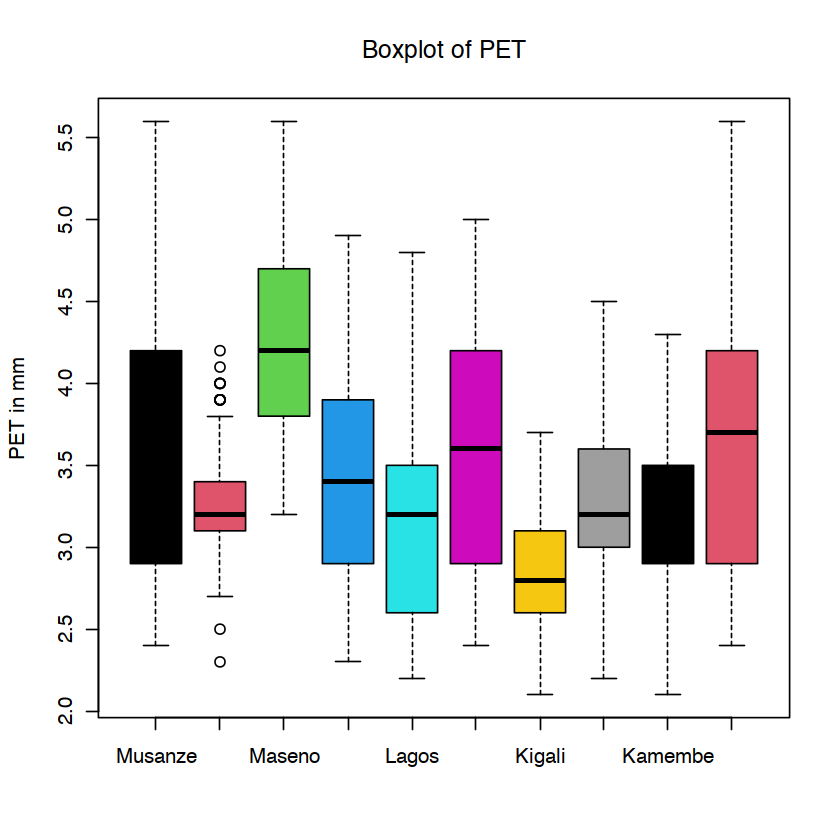

In [7]:

boxplot(cities,col=1:10,main="Boxplot of PET",ylab="PET in mm")

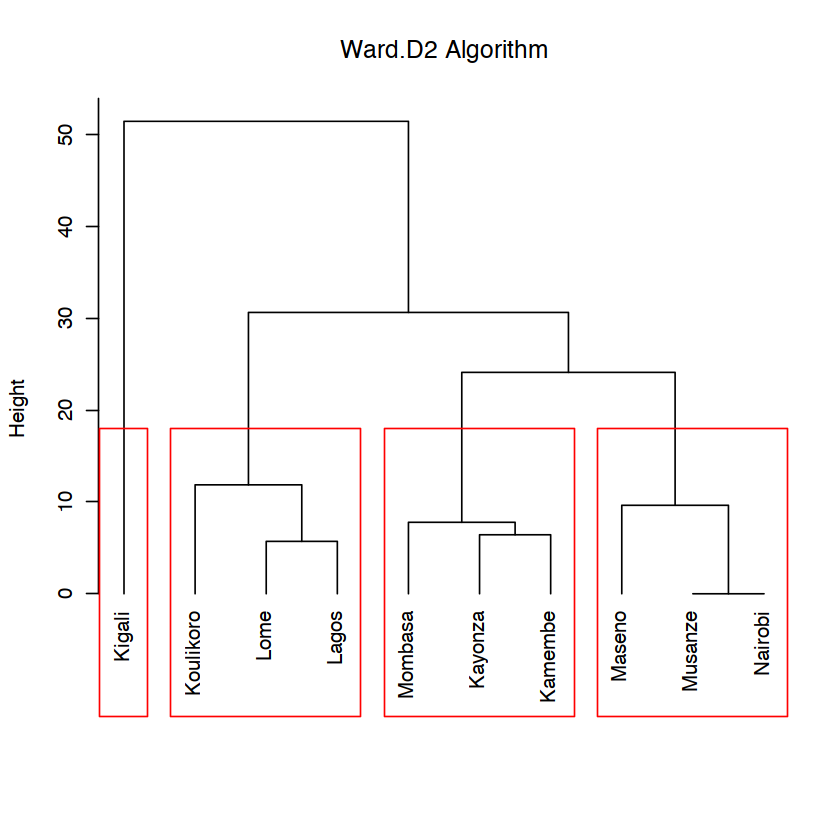

In [8]:


####### performing the clustering############
cities.august.scaled.clus=hclust(dist(t(scale(cities))),method='ward.D2')

#####plotting the tree#################
#plot(cities.august.scaled.clus,hang=-6,col="blue")

#cutree(cities.august.scaled.clus,k=4)


plot(cities.august.scaled.clus,hang=-2, main = 'Ward.D2 Algorithm',xlab =" ", sub ="")
rect.hclust(cities.august.scaled.clus, k =4, border = 'red') ## selecting three clusters



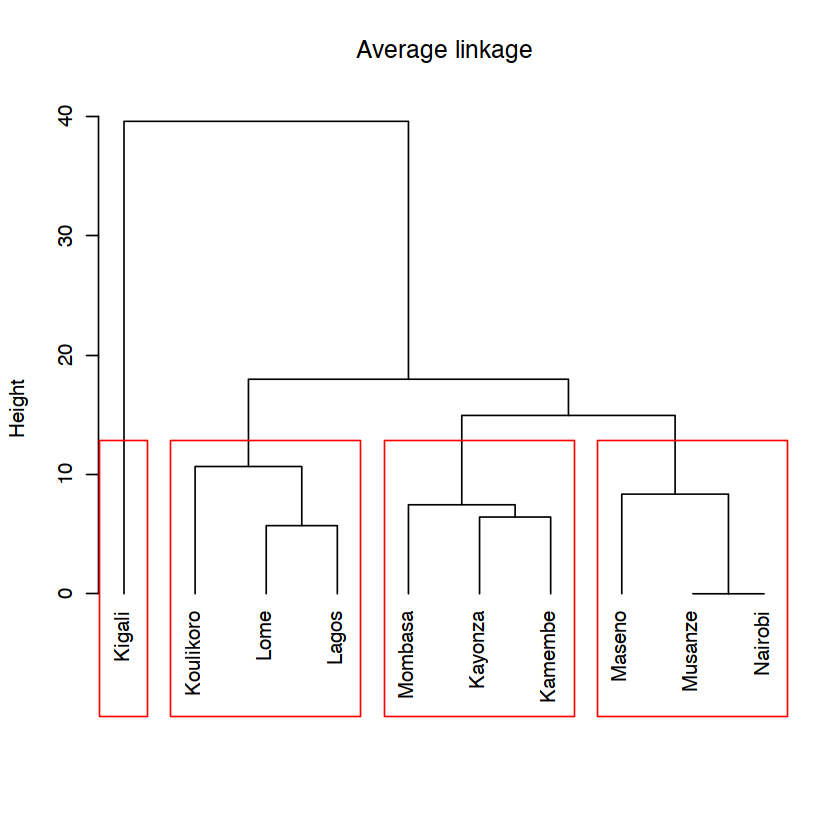

In [9]:
####### performing the clustering############
cities.august.scaled.clus=hclust(dist(t(scale(cities))),method='average')

#####plotting the tree#################
#plot(cities.august.scaled.clus,hang=-6,col="brown")

#cutree(cities.august.scaled.clus,k=4)
plot(cities.august.scaled.clus,hang=-2, main = 'Average linkage',xlab =" ", sub ="")
rect.hclust(cities.august.scaled.clus, k =4, border = 'red') ## selecting three clusters

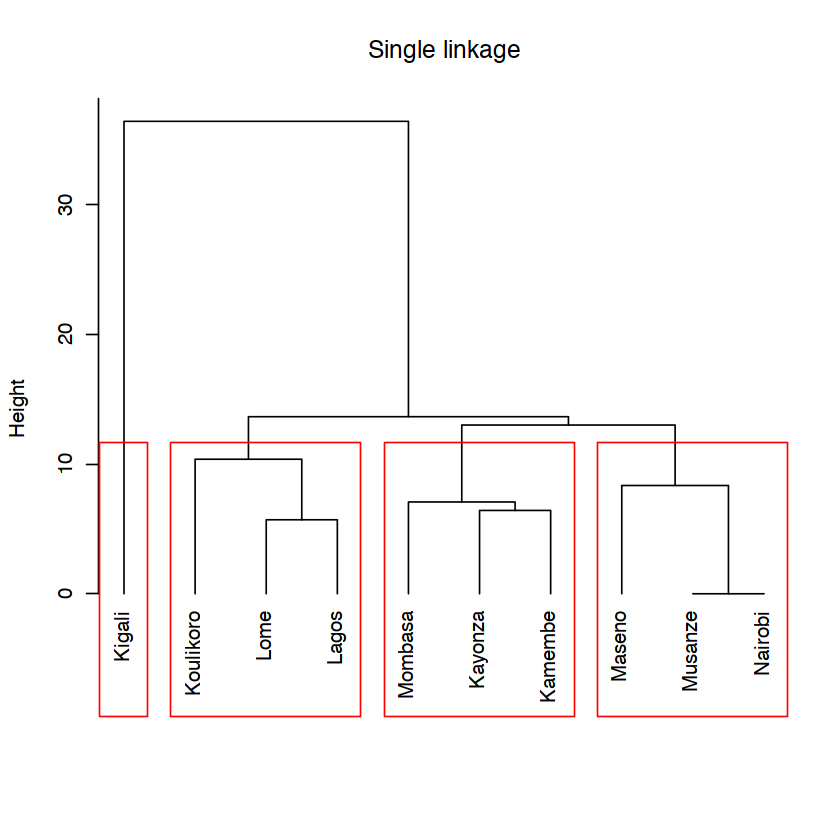

In [10]:
####### performing the clustering############
cities.august.scaled.clus=hclust(dist(t(scale(cities))),method='single')

#####plotting the tree#################
#plot(cities.august.scaled.clus,hang=-6,col="red")

#cutree(yy.clus,k=4)

plot(cities.august.scaled.clus, main = 'Single linkage',xlab =" ", hang=-2,sub ="")
rect.hclust(cities.august.scaled.clus, k =4, border = 'red') ## selecting three clusters

## Exercise 2: Principal Component Analysis (PCA)

In [11]:
## Unrotated PCA
pc1 <- principal(scale(cities), nfactors = 2, rotate = "none")

Warning message in log(det(m.inv.r)):
“NaNs produced”
The determinant of the smoothed correlation was zero.
This means the objective function is not defined for the null model either.
The Chi square is thus based upon observed correlations.

In factor.stats, the correlation matrix is singular, an approximation is used

Warning message in principal(scale(cities), nfactors = 2, rotate = "none"):
“The matrix is not positive semi-definite, scores found from Structure loadings”


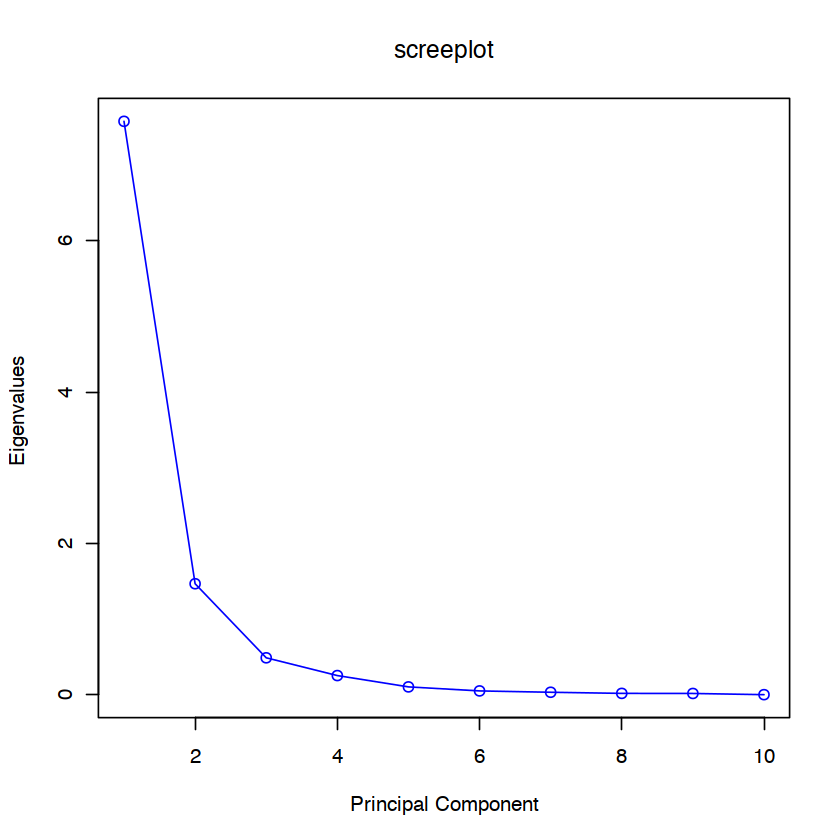

In [12]:
#par(mfrow = c(1,2))
pve <- 100* pc1$values/sum(pc1$values) 
plot(pc1$values, type ="o" , ylab ="Eigenvalues " , xlab ="Principal Component" ,
     col ="blue", main = 'screeplot')

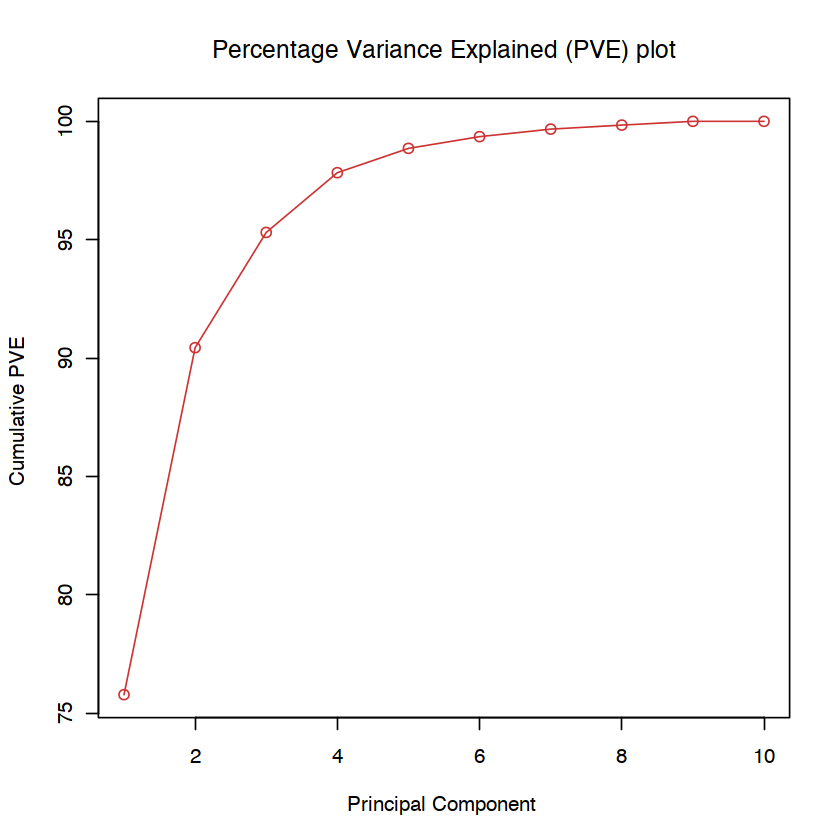

In [13]:
plot (cumsum(pve) , type ="o" , ylab ="Cumulative PVE " , xlab ="Principal Component " , col ="brown3 ",
      main = 'Percentage Variance Explained (PVE) plot')

In [20]:
pc2 <- principal(scale(cities), nfactors = 4, rotate = "varimax") 

scores<- as.data.frame(pc2$scores)  #scores after rotation

The determinant of the smoothed correlation was zero.
This means the objective function is not defined.
Chi square is based upon observed residuals.

The determinant of the smoothed correlation was zero.
This means the objective function is not defined for the null model either.
The Chi square is thus based upon observed correlations.

In factor.stats, the correlation matrix is singular, an approximation is used

Warning message in principal(scale(cities), nfactors = 4, rotate = "varimax"):
“The matrix is not positive semi-definite, scores found from Structure loadings”


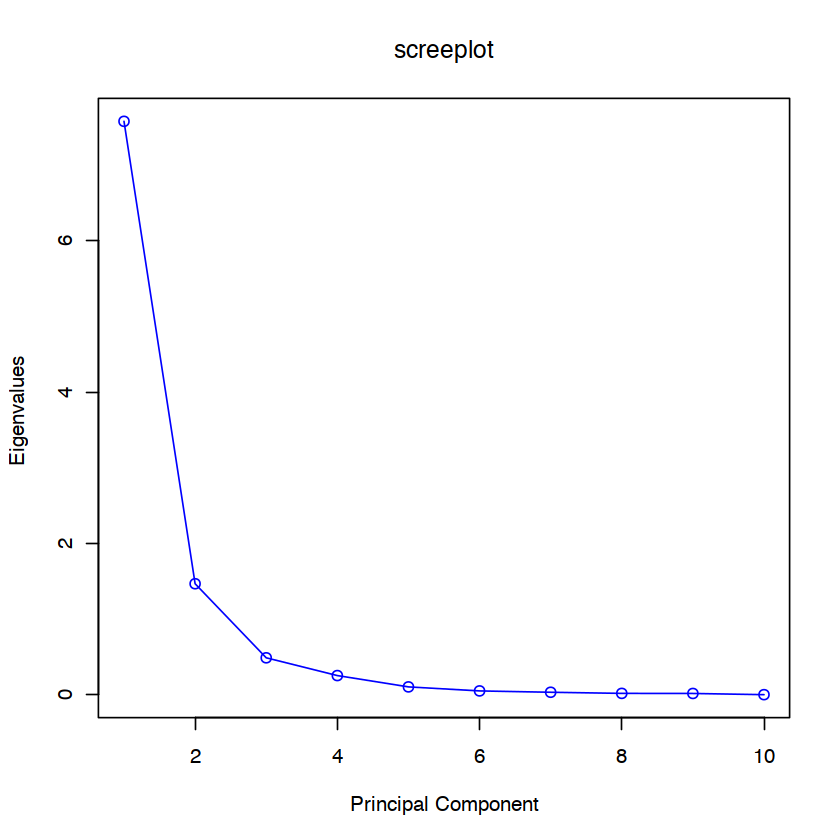

In [14]:
#par(mfrow = c(1,2))
pve <- 100* pc2$values/sum(pc2$values) 
plot(pc1$values, type ="o" , ylab ="Eigenvalues " , xlab ="Principal Component" ,
     col ="blue", main = 'screeplot')

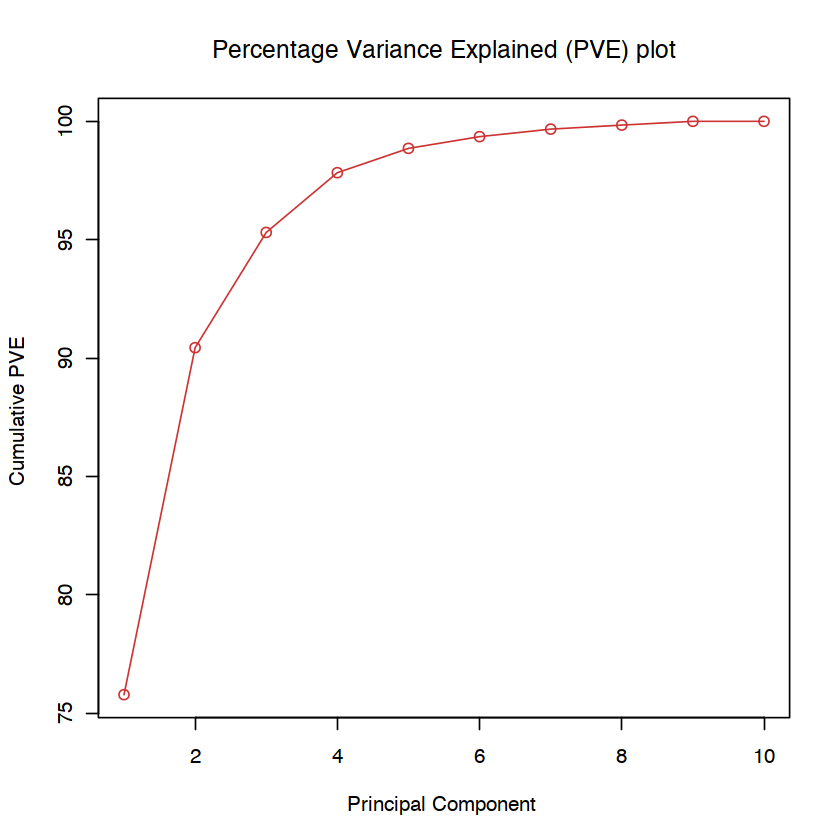

In [15]:
plot (cumsum(pve) , type ="o" , ylab ="Cumulative PVE " , xlab ="Principal Component " , col ="brown3 ",
      main = 'Percentage Variance Explained (PVE) plot')

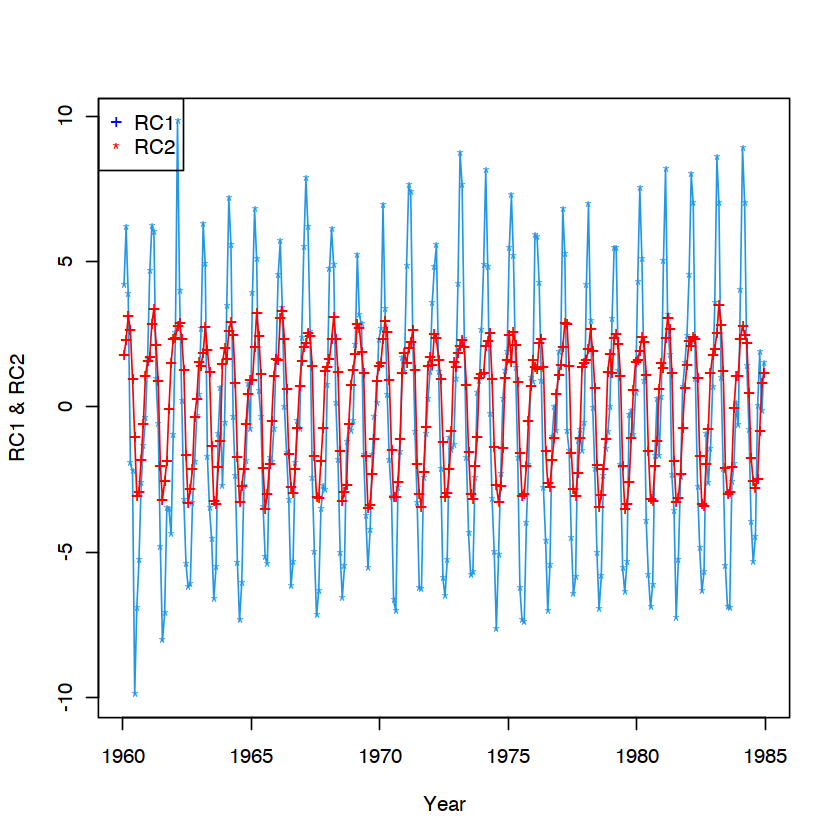

In [16]:
#plotting some of the scores
#plot(as.Date(cities_dataset$Date, '%m/%d/%Y'),scores$RC1,type ="o", xlab = 'year', ylab='RC1', main='Rotated Component 1')

#par(mfrow = c(3,2))
#Time Series of PCA RC1

plot(as.Date(cities_dataset$Date[1:300],"%d/%m/%Y"),scores$RC1[1:300],type="o",col=4,
xlab="Year", ylab="RC1 & RC2",
main="",pch="*")
lines(as.Date(cities_dataset$Date[1:300],"%d/%m/%Y"),scores$RC2[1:300],col="red",type="o",pch="+")
legend( x= "topleft", y=0.92, 
        legend=c("RC1","RC2"), 
        col=c("blue", "red"),   
        pch=c("+","*"))



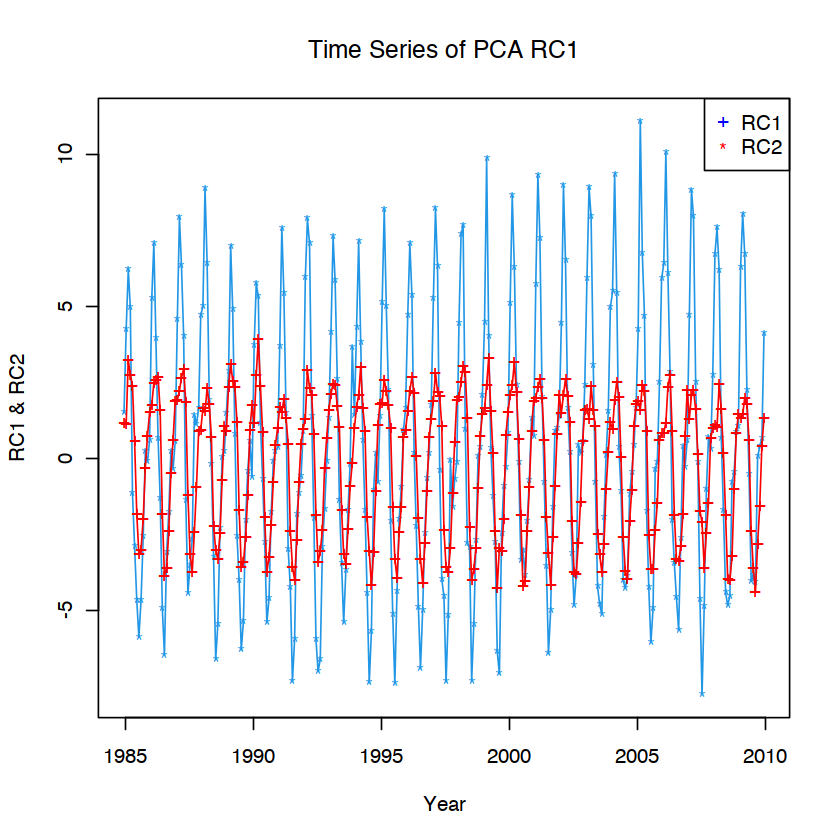

In [17]:
plot(as.Date(cities_dataset$Date[300:600],"%d/%m/%Y"),scores$RC1[300:600],type="o",col=4,
xlab="Year", ylab="RC1 & RC2",
main="Time Series of PCA RC1",pch="*")
lines(as.Date(cities_dataset$Date[300:600],"%d/%m/%Y"),scores$RC2[300:600],col="red",type="o",pch="+")
legend( x= "topright", y=0.92, 
        legend=c("RC1","RC2"), 
        col=c("blue", "red"),   
        pch=c("+","*"))




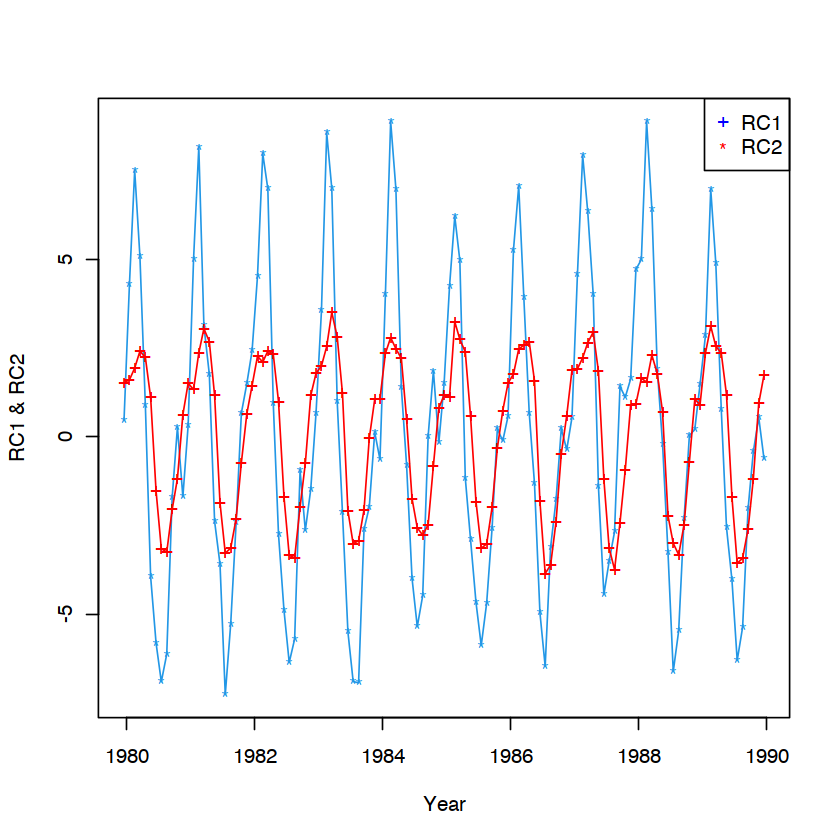

In [18]:
plot(as.Date(cities_dataset$Date[240:360],"%d/%m/%Y"),scores$RC1[240:360],type="o",col=4,
xlab="Year", ylab="RC1 & RC2",
main="",pch="*")
lines(as.Date(cities_dataset$Date[240:360],"%d/%m/%Y"),scores$RC2[240:360],col="red",type="o",pch="+")
legend( x= "topright", y=0.92, 
        legend=c("RC1","RC2"), 
        col=c("blue", "red"),   
        pch=c("+","*"))



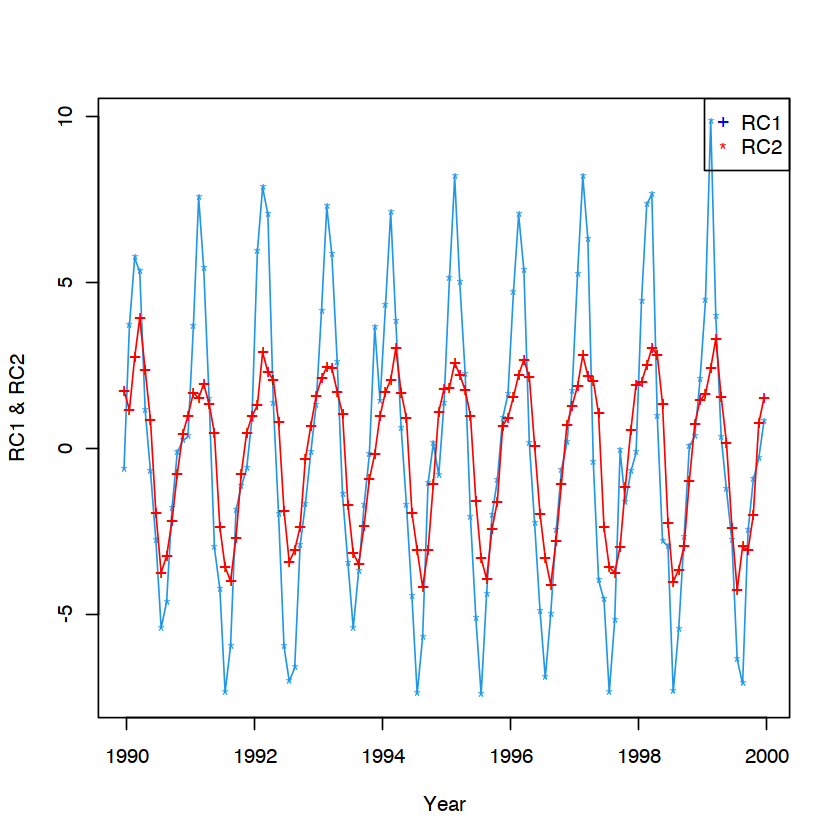

In [19]:
plot(as.Date(cities_dataset$Date[360:480],"%d/%m/%Y"),scores$RC1[360:480],type="o",col=4,
xlab="Year", ylab="RC1 & RC2",
main="",pch="*")
lines(as.Date(cities_dataset$Date[360:480],"%d/%m/%Y"),scores$RC2[360:480],col="red",type="o",pch="+")
legend( x= "topright", y=0.92, 
        legend=c("RC1","RC2"), 
        col=c("blue", "red"),   
        pch=c("+","*"))



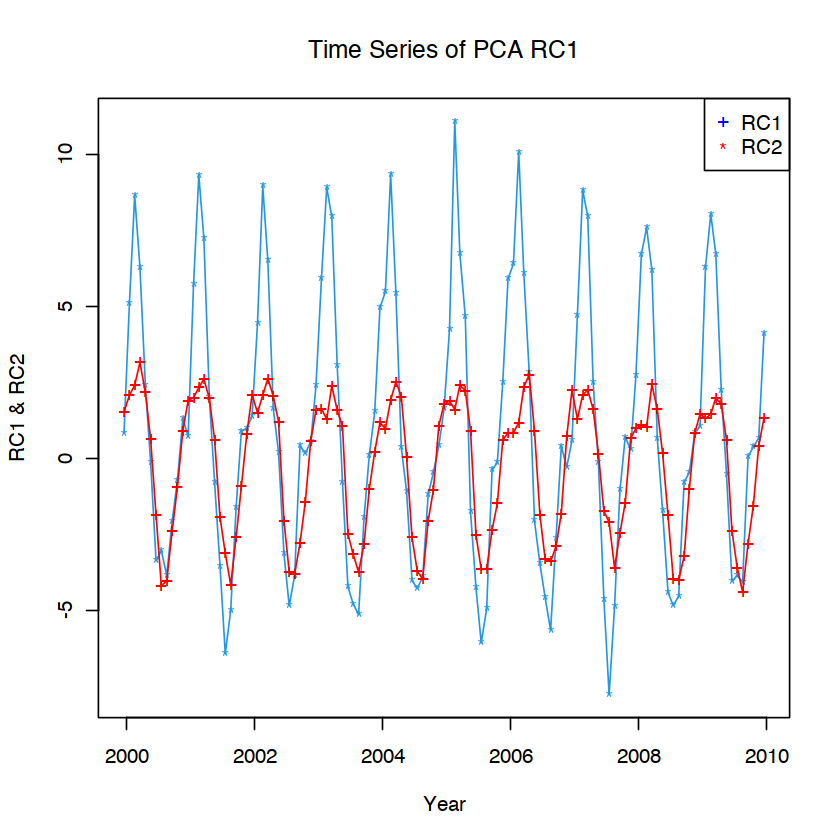

In [20]:
plot(as.Date(cities_dataset$Date[480:600],"%d/%m/%Y"),scores$RC1[480:600],type="o",col=4,
xlab="Year", ylab="RC1 & RC2",
main="Time Series of PCA RC1",pch="*")
lines(as.Date(cities_dataset$Date[480:600],"%d/%m/%Y"),scores$RC2[480:600],col="red",type="o",pch="+")
legend( x= "topright", y=0.92, 
        legend=c("RC1","RC2"), 
        col=c("blue", "red"),   
        pch=c("+","*"))

In [64]:
x <-  as.Date(cities_dataset$Date[1:360],"%d/%m/%Y")
y <- scores$RC1[1:360]
y2 <- scores$RC2[1:360]

fig <- plot_ly(
  type = "scatter",
  x = ~x, 
  y = ~y,
  name = 'RC1',
  mode = "lines",
  line = list(
        color = '#17BECF'
  )) 
fig <- fig %>%
  add_trace(
    type = "scatter",
    x = ~ x, 
    y = ~y2,
    name = 'RC2',
    mode = "lines",
    line = list(
        color = '#7F7F7F'
  )) 
fig <- fig %>%
  layout(
    title = "Time Series PCA Rotated Components Scores",
    xaxis = list(
        type = 'date',
        tickformat = "%Y",
        autotick = T,
        showticklabels = TRUE,
        title = "Year"
  ),yaxis = list(
        title = 'RC Scores'
  ))

embed_notebook(fig)

<iframe src="data:text/html;charset=utf-8;base64,PCFET0NUWVBFIGh0bWw+CjxodG1sPgo8aGVhZD4KPG1ldGEgY2hhcnNldD0idXRmLTgiIC8+Cjx0aXRsZT5wbG90bHk8L3RpdGxlPgo8c2NyaXB0PihmdW5jdGlvbigpIHsKICAvLyBJZiB3aW5kb3cuSFRNTFdpZGdldHMgaXMgYWxyZWFkeSBkZWZpbmVkLCB0aGVuIHVzZSBpdDsgb3RoZXJ3aXNlIGNyZWF0ZSBhCiAgLy8gbmV3IG9iamVjdC4gVGhpcyBhbGxvd3MgcHJlY2VkaW5nIGNvZGUgdG8gc2V0IG9wdGlvbnMgdGhhdCBhZmZlY3QgdGhlCiAgLy8gaW5pdGlhbGl6YXRpb24gcHJvY2VzcyAodGhvdWdoIG5vbmUgY3VycmVudGx5IGV4aXN0KS4KICB3aW5kb3cuSFRNTFdpZGdldHMgPSB3aW5kb3cuSFRNTFdpZGdldHMgfHwge307CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIGEgdmlld2VyIHBhbmUuIElmIG5vdCwgd2UncmUgaW4gYSB3ZWIgYnJvd3Nlci4KICB2YXIgdmlld2VyTW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy52aWV3ZXJNb2RlID0KICAgICAgL1xidmlld2VyX3BhbmU9MVxiLy50ZXN0KHdpbmRvdy5sb2NhdGlvbik7CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIFNoaW55IG1vZGUuIElmIG5vdCwgaXQncyBhIHN0YXRpYyBkb2N1bWVudC4KICAvLyBOb3RlIHRoYXQgc3RhdGljIHdpZGdldHMgY2FuIGFwcGVhciBpbiBib3RoIFNoaW55IGFuZCBzdGF0aWMgbW9kZXMsIGJ1dAogIC8vIG9idmlvdXNseSwgU2hpbnkgd2lkZ2V0cyBjYW4gb25seSBhcHBlYXIgaW4gU2hpbnkgYXBwcy9kb2N1bWVudHMuCiAgdmFyIHNoaW55TW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy5zaGlueU1vZGUgPQogICAgICB0eXBlb2Yod2luZG93LlNoaW55KSAhPT0gInVuZGVmaW5lZCIgJiYgISF3aW5kb3cuU2hpbnkub3V0cHV0QmluZGluZ3M7CgogIC8vIFdlIGNhbid0IGNvdW50IG9uIGpRdWVyeSBiZWluZyBhdmFpbGFibGUsIHNvIHdlIGltcGxlbWVudCBvdXIgb3duCiAgLy8gdmVyc2lvbiBpZiBuZWNlc3NhcnkuCiAgZnVuY3Rpb24gcXVlcnlTZWxlY3RvckFsbChzY29wZSwgc2VsZWN0b3IpIHsKICAgIGlmICh0eXBlb2YoalF1ZXJ5KSAhPT0gInVuZGVmaW5lZCIgJiYgc2NvcGUgaW5zdGFuY2VvZiBqUXVlcnkpIHsKICAgICAgcmV0dXJuIHNjb3BlLmZpbmQoc2VsZWN0b3IpOwogICAgfQogICAgaWYgKHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwpIHsKICAgICAgcmV0dXJuIHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwoc2VsZWN0b3IpOwogICAgfQogIH0KCiAgZnVuY3Rpb24gYXNBcnJheSh2YWx1ZSkgewogICAgaWYgKHZhbHVlID09PSBudWxsKQogICAgICByZXR1cm4gW107CiAgICBpZiAoJC5pc0FycmF5KHZhbHVlKSkKICAgICAgcmV0dXJuIHZhbHVlOwogICAgcmV0dXJuIFt2YWx1ZV07CiAgfQoKICAvLyBJbXBsZW1lbnQgalF1ZXJ5J3MgZXh0ZW5kCiAgZnVuY3Rpb24gZXh0ZW5kKHRhcmdldCAvKiwgLi4uICovKSB7CiAgICBpZiAoYXJndW1lbnRzLmxlbmd0aCA9PSAxKSB7CiAgICAgIHJldHVybiB0YXJnZXQ7CiAgICB9CiAgICBmb3IgKHZhciBpID0gMTsgaSA8IGFyZ3VtZW50cy5sZW5ndGg7IGkrKykgewogICAgICB2YXIgc291cmNlID0gYXJndW1lbnRzW2ldOwogICAgICBmb3IgKHZhciBwcm9wIGluIHNvdXJjZSkgewogICAgICAgIGlmIChzb3VyY2UuaGFzT3duUHJvcGVydHkocHJvcCkpIHsKICAgICAgICAgIHRhcmdldFtwcm9wXSA9IHNvdXJjZVtwcm9wXTsKICAgICAgICB9CiAgICAgIH0KICAgIH0KICAgIHJldHVybiB0YXJnZXQ7CiAgfQoKICAvLyBJRTggZG9lc24ndCBzdXBwb3J0IEFycmF5LmZvckVhY2guCiAgZnVuY3Rpb24gZm9yRWFjaCh2YWx1ZXMsIGNhbGxiYWNrLCB0aGlzQXJnKSB7CiAgICBpZiAodmFsdWVzLmZvckVhY2gpIHsKICAgICAgdmFsdWVzLmZvckVhY2goY2FsbGJhY2ssIHRoaXNBcmcpOwogICAgfSBlbHNlIHsKICAgICAgZm9yICh2YXIgaSA9IDA7IGkgPCB2YWx1ZXMubGVuZ3RoOyBpKyspIHsKICAgICAgICBjYWxsYmFjay5jYWxsKHRoaXNBcmcsIHZhbHVlc1tpXSwgaSwgdmFsdWVzKTsKICAgICAgfQogICAgfQogIH0KCiAgLy8gUmVwbGFjZXMgdGhlIHNwZWNpZmllZCBtZXRob2Qgd2l0aCB0aGUgcmV0dXJuIHZhbHVlIG9mIGZ1bmNTb3VyY2UuCiAgLy8KICAvLyBOb3RlIHRoYXQgZnVuY1NvdXJjZSBzaG91bGQgbm90IEJFIHRoZSBuZXcgbWV0aG9kLCBpdCBzaG91bGQgYmUgYSBmdW5jdGlvbgogIC8vIHRoYXQgUkVUVVJOUyB0aGUgbmV3IG1ldGhvZC4gZnVuY1NvdXJjZSByZWNlaXZlcyBhIHNpbmdsZSBhcmd1bWVudCB0aGF0IGlzCiAgLy8gdGhlIG92ZXJyaWRkZW4gbWV0aG9kLCBpdCBjYW4gYmUgY2FsbGVkIGZyb20gdGhlIG5ldyBtZXRob2QuIFRoZSBvdmVycmlkZGVuCiAgLy8gbWV0aG9kIGNhbiBiZSBjYWxsZWQgbGlrZSBhIHJlZ3VsYXIgZnVuY3Rpb24sIGl0IGhhcyB0aGUgdGFyZ2V0IHBlcm1hbmVudGx5CiAgLy8gYm91bmQgdG8gaXQgc28gInRoaXMiIHdpbGwgd29yayBjb3JyZWN0bHkuCiAgZnVuY3Rpb24gb3ZlcnJpZGVNZXRob2QodGFyZ2V0LCBtZXRob2ROYW1lLCBmdW5jU291cmNlKSB7CiAgICB2YXIgc3VwZXJGdW5jID0gdGFyZ2V0W21ldGhvZE5hbWVdIHx8IGZ1bmN0aW9uKCkge307CiAgICB2YXIgc3VwZXJGdW5jQm91bmQgPSBmdW5jdGlvbigpIHsKICAgICAgcmV0dXJuIHN1cGVyRnVuYy5hcHBseSh0YXJnZXQsIGFyZ3VtZW50cyk7CiAgICB9OwogICAgdGFyZ2V0W21ldGhvZE5hbWVdID0gZnVuY1NvdXJjZShzdXBlckZ1bmNCb3VuZCk7CiAgfQoKICAvLyBBZGQgYSBtZXRob2QgdG8gZGVsZWdhdG9yIHRoYXQsIHdoZW4gaW52b2tlZCwgY2FsbHMKICAvLyBkZWxlZ2F0ZWUubWV0aG9kTmFtZS4gSWYgdGhlcmUgaXMgbm8gc3VjaCBtZXRob2Qgb24KICAvLyB0aGUgZGVsZWdhdGVlLCBidXQgdGhlcmUgd2FzIG9uZSBvbiBkZWxlZ2F0b3IgYmVmb3JlCiAgLy8gZGVsZWdhdGVNZXRob2Qgd2FzIGNhbGxlZCwgdGhlbiB

#### Access to the PCA results

In [21]:
pc2$loadings



Loadings:
          RC3    RC1    RC4    RC2    RC5    RC7    RC6    RC9    RC8    RC10  
Musanze    0.866  0.400  0.272               -0.110                            
Mombasa    0.443  0.830  0.328                                                 
Maseno     0.899  0.301  0.233                0.200                            
Lome       0.378  0.397  0.750  0.352                       0.112              
Lagos      0.333  0.380  0.777  0.358                                          
Koulikoro  0.389  0.481  0.534  0.478  0.323                                   
Kigali                  -0.242 -0.970                                          
Kayonza    0.547  0.737  0.322  0.132                0.162                     
Kamembe    0.504  0.748  0.373  0.178                              0.119       
Nairobi    0.866  0.400  0.272               -0.110                            

                 RC3   RC1   RC4   RC2   RC5   RC7   RC6   RC9   RC8 RC10
SS loadings    3.463 2.736 2.061 1

In [22]:
summary(pc2)


Factor analysis with Call: principal(r = scale(cities), nfactors = 10, rotate = "varimax")

Test of the hypothesis that 10 factors are sufficient.
The degrees of freedom for the model is -10  and the objective function was  0 
The number of observations was  612  with Chi Square =  0  with prob <  NA 

The root mean square of the residuals (RMSA) is  0 


In [23]:
pc2$values

[1] 7.577546e+00 1.466033e+00 4.870469e-01 2.524123e-01 1.026978e-01
 [6] 4.955822e-02 3.180026e-02 1.700531e-02 1.590053e-02 3.545179e-16

## Task 3: Time-series Analysis Part I (Auto-correlation and Cross-correlation)

The aim of this task is to explore the time series patterns in the variable over the cities used in
the previous tasks. Rather than analysis the time-series of the variable over each city, you will
analyse the score of the two principal factors from your PCA.

### (i) Plot the time series with a linear line of best fit. Conclude on whether the time series shows trend.

In [24]:
x <-  as.Date(cities_dataset$Date[1:360],"%d/%m/%Y")
y <- scores$RC1[1:360]
y2 <- scores$RC2[1:360]
m1 = lm(y~x)

fig <- plot_ly(
  type = "scatter",
  x = ~x, 
  y = ~y,
  name = 'RC1',
  mode = "lines",
  line = list(
        color = '#17BECF'
  )) 

fig <- fig %>%
  add_trace(
    type = "scatter",
    x = ~ x, 
    y = ~predict(m1),
    name = 'Linear Fit',
    mode = "lines",
    line = list(
        color = 'red'
  )) 

fig <- fig %>%
  layout(
    title = "Time Series PCA RC1 Linear Fit",
    xaxis = list(
        type = 'date',
        tickformat = "%Y",
        autotick = T,
        showticklabels = TRUE,
        title = "Year"
  ),yaxis = list(
        title = 'RC1'
  ))

embed_notebook(fig)

<iframe src="data:text/html;charset=utf-8;base64,PCFET0NUWVBFIGh0bWw+CjxodG1sPgo8aGVhZD4KPG1ldGEgY2hhcnNldD0idXRmLTgiIC8+Cjx0aXRsZT5wbG90bHk8L3RpdGxlPgo8c2NyaXB0PihmdW5jdGlvbigpIHsKICAvLyBJZiB3aW5kb3cuSFRNTFdpZGdldHMgaXMgYWxyZWFkeSBkZWZpbmVkLCB0aGVuIHVzZSBpdDsgb3RoZXJ3aXNlIGNyZWF0ZSBhCiAgLy8gbmV3IG9iamVjdC4gVGhpcyBhbGxvd3MgcHJlY2VkaW5nIGNvZGUgdG8gc2V0IG9wdGlvbnMgdGhhdCBhZmZlY3QgdGhlCiAgLy8gaW5pdGlhbGl6YXRpb24gcHJvY2VzcyAodGhvdWdoIG5vbmUgY3VycmVudGx5IGV4aXN0KS4KICB3aW5kb3cuSFRNTFdpZGdldHMgPSB3aW5kb3cuSFRNTFdpZGdldHMgfHwge307CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIGEgdmlld2VyIHBhbmUuIElmIG5vdCwgd2UncmUgaW4gYSB3ZWIgYnJvd3Nlci4KICB2YXIgdmlld2VyTW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy52aWV3ZXJNb2RlID0KICAgICAgL1xidmlld2VyX3BhbmU9MVxiLy50ZXN0KHdpbmRvdy5sb2NhdGlvbik7CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIFNoaW55IG1vZGUuIElmIG5vdCwgaXQncyBhIHN0YXRpYyBkb2N1bWVudC4KICAvLyBOb3RlIHRoYXQgc3RhdGljIHdpZGdldHMgY2FuIGFwcGVhciBpbiBib3RoIFNoaW55IGFuZCBzdGF0aWMgbW9kZXMsIGJ1dAogIC8vIG9idmlvdXNseSwgU2hpbnkgd2lkZ2V0cyBjYW4gb25seSBhcHBlYXIgaW4gU2hpbnkgYXBwcy9kb2N1bWVudHMuCiAgdmFyIHNoaW55TW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy5zaGlueU1vZGUgPQogICAgICB0eXBlb2Yod2luZG93LlNoaW55KSAhPT0gInVuZGVmaW5lZCIgJiYgISF3aW5kb3cuU2hpbnkub3V0cHV0QmluZGluZ3M7CgogIC8vIFdlIGNhbid0IGNvdW50IG9uIGpRdWVyeSBiZWluZyBhdmFpbGFibGUsIHNvIHdlIGltcGxlbWVudCBvdXIgb3duCiAgLy8gdmVyc2lvbiBpZiBuZWNlc3NhcnkuCiAgZnVuY3Rpb24gcXVlcnlTZWxlY3RvckFsbChzY29wZSwgc2VsZWN0b3IpIHsKICAgIGlmICh0eXBlb2YoalF1ZXJ5KSAhPT0gInVuZGVmaW5lZCIgJiYgc2NvcGUgaW5zdGFuY2VvZiBqUXVlcnkpIHsKICAgICAgcmV0dXJuIHNjb3BlLmZpbmQoc2VsZWN0b3IpOwogICAgfQogICAgaWYgKHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwpIHsKICAgICAgcmV0dXJuIHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwoc2VsZWN0b3IpOwogICAgfQogIH0KCiAgZnVuY3Rpb24gYXNBcnJheSh2YWx1ZSkgewogICAgaWYgKHZhbHVlID09PSBudWxsKQogICAgICByZXR1cm4gW107CiAgICBpZiAoJC5pc0FycmF5KHZhbHVlKSkKICAgICAgcmV0dXJuIHZhbHVlOwogICAgcmV0dXJuIFt2YWx1ZV07CiAgfQoKICAvLyBJbXBsZW1lbnQgalF1ZXJ5J3MgZXh0ZW5kCiAgZnVuY3Rpb24gZXh0ZW5kKHRhcmdldCAvKiwgLi4uICovKSB7CiAgICBpZiAoYXJndW1lbnRzLmxlbmd0aCA9PSAxKSB7CiAgICAgIHJldHVybiB0YXJnZXQ7CiAgICB9CiAgICBmb3IgKHZhciBpID0gMTsgaSA8IGFyZ3VtZW50cy5sZW5ndGg7IGkrKykgewogICAgICB2YXIgc291cmNlID0gYXJndW1lbnRzW2ldOwogICAgICBmb3IgKHZhciBwcm9wIGluIHNvdXJjZSkgewogICAgICAgIGlmIChzb3VyY2UuaGFzT3duUHJvcGVydHkocHJvcCkpIHsKICAgICAgICAgIHRhcmdldFtwcm9wXSA9IHNvdXJjZVtwcm9wXTsKICAgICAgICB9CiAgICAgIH0KICAgIH0KICAgIHJldHVybiB0YXJnZXQ7CiAgfQoKICAvLyBJRTggZG9lc24ndCBzdXBwb3J0IEFycmF5LmZvckVhY2guCiAgZnVuY3Rpb24gZm9yRWFjaCh2YWx1ZXMsIGNhbGxiYWNrLCB0aGlzQXJnKSB7CiAgICBpZiAodmFsdWVzLmZvckVhY2gpIHsKICAgICAgdmFsdWVzLmZvckVhY2goY2FsbGJhY2ssIHRoaXNBcmcpOwogICAgfSBlbHNlIHsKICAgICAgZm9yICh2YXIgaSA9IDA7IGkgPCB2YWx1ZXMubGVuZ3RoOyBpKyspIHsKICAgICAgICBjYWxsYmFjay5jYWxsKHRoaXNBcmcsIHZhbHVlc1tpXSwgaSwgdmFsdWVzKTsKICAgICAgfQogICAgfQogIH0KCiAgLy8gUmVwbGFjZXMgdGhlIHNwZWNpZmllZCBtZXRob2Qgd2l0aCB0aGUgcmV0dXJuIHZhbHVlIG9mIGZ1bmNTb3VyY2UuCiAgLy8KICAvLyBOb3RlIHRoYXQgZnVuY1NvdXJjZSBzaG91bGQgbm90IEJFIHRoZSBuZXcgbWV0aG9kLCBpdCBzaG91bGQgYmUgYSBmdW5jdGlvbgogIC8vIHRoYXQgUkVUVVJOUyB0aGUgbmV3IG1ldGhvZC4gZnVuY1NvdXJjZSByZWNlaXZlcyBhIHNpbmdsZSBhcmd1bWVudCB0aGF0IGlzCiAgLy8gdGhlIG92ZXJyaWRkZW4gbWV0aG9kLCBpdCBjYW4gYmUgY2FsbGVkIGZyb20gdGhlIG5ldyBtZXRob2QuIFRoZSBvdmVycmlkZGVuCiAgLy8gbWV0aG9kIGNhbiBiZSBjYWxsZWQgbGlrZSBhIHJlZ3VsYXIgZnVuY3Rpb24sIGl0IGhhcyB0aGUgdGFyZ2V0IHBlcm1hbmVudGx5CiAgLy8gYm91bmQgdG8gaXQgc28gInRoaXMiIHdpbGwgd29yayBjb3JyZWN0bHkuCiAgZnVuY3Rpb24gb3ZlcnJpZGVNZXRob2QodGFyZ2V0LCBtZXRob2ROYW1lLCBmdW5jU291cmNlKSB7CiAgICB2YXIgc3VwZXJGdW5jID0gdGFyZ2V0W21ldGhvZE5hbWVdIHx8IGZ1bmN0aW9uKCkge307CiAgICB2YXIgc3VwZXJGdW5jQm91bmQgPSBmdW5jdGlvbigpIHsKICAgICAgcmV0dXJuIHN1cGVyRnVuYy5hcHBseSh0YXJnZXQsIGFyZ3VtZW50cyk7CiAgICB9OwogICAgdGFyZ2V0W21ldGhvZE5hbWVdID0gZnVuY1NvdXJjZShzdXBlckZ1bmNCb3VuZCk7CiAgfQoKICAvLyBBZGQgYSBtZXRob2QgdG8gZGVsZWdhdG9yIHRoYXQsIHdoZW4gaW52b2tlZCwgY2FsbHMKICAvLyBkZWxlZ2F0ZWUubWV0aG9kTmFtZS4gSWYgdGhlcmUgaXMgbm8gc3VjaCBtZXRob2Qgb24KICAvLyB0aGUgZGVsZWdhdGVlLCBidXQgdGhlcmUgd2FzIG9uZSBvbiBkZWxlZ2F0b3IgYmVmb3JlCiAgLy8gZGVsZWdhdGVNZXRob2Qgd2FzIGNhbGxlZCwgdGhlbiB

In [25]:
m2 = lm(y2~x)

fig <- plot_ly(
  type = "scatter",
  x = ~x, 
  y = ~y2,
  name = 'RC2',
  mode = "lines",
  line = list(
        color = '#17BECF'
  )) 

fig <- fig %>%
  add_trace(
    type = "scatter",
    x = ~ x, 
    y = ~predict(m2),
    name = 'Linear Fit',
    mode = "lines",
    line = list(
        color = 'red'
  )) 

fig <- fig %>%
  layout(
    title = "Time Series PCA RC2 Linear Fit",
    xaxis = list(
        type = 'date',
        tickformat = "%Y",
        autotick = T,
        showticklabels = TRUE,
        title = "Year"
  ),yaxis = list(
        title = 'RC2'
  ))

embed_notebook(fig)

<iframe src="data:text/html;charset=utf-8;base64,PCFET0NUWVBFIGh0bWw+CjxodG1sPgo8aGVhZD4KPG1ldGEgY2hhcnNldD0idXRmLTgiIC8+Cjx0aXRsZT5wbG90bHk8L3RpdGxlPgo8c2NyaXB0PihmdW5jdGlvbigpIHsKICAvLyBJZiB3aW5kb3cuSFRNTFdpZGdldHMgaXMgYWxyZWFkeSBkZWZpbmVkLCB0aGVuIHVzZSBpdDsgb3RoZXJ3aXNlIGNyZWF0ZSBhCiAgLy8gbmV3IG9iamVjdC4gVGhpcyBhbGxvd3MgcHJlY2VkaW5nIGNvZGUgdG8gc2V0IG9wdGlvbnMgdGhhdCBhZmZlY3QgdGhlCiAgLy8gaW5pdGlhbGl6YXRpb24gcHJvY2VzcyAodGhvdWdoIG5vbmUgY3VycmVudGx5IGV4aXN0KS4KICB3aW5kb3cuSFRNTFdpZGdldHMgPSB3aW5kb3cuSFRNTFdpZGdldHMgfHwge307CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIGEgdmlld2VyIHBhbmUuIElmIG5vdCwgd2UncmUgaW4gYSB3ZWIgYnJvd3Nlci4KICB2YXIgdmlld2VyTW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy52aWV3ZXJNb2RlID0KICAgICAgL1xidmlld2VyX3BhbmU9MVxiLy50ZXN0KHdpbmRvdy5sb2NhdGlvbik7CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIFNoaW55IG1vZGUuIElmIG5vdCwgaXQncyBhIHN0YXRpYyBkb2N1bWVudC4KICAvLyBOb3RlIHRoYXQgc3RhdGljIHdpZGdldHMgY2FuIGFwcGVhciBpbiBib3RoIFNoaW55IGFuZCBzdGF0aWMgbW9kZXMsIGJ1dAogIC8vIG9idmlvdXNseSwgU2hpbnkgd2lkZ2V0cyBjYW4gb25seSBhcHBlYXIgaW4gU2hpbnkgYXBwcy9kb2N1bWVudHMuCiAgdmFyIHNoaW55TW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy5zaGlueU1vZGUgPQogICAgICB0eXBlb2Yod2luZG93LlNoaW55KSAhPT0gInVuZGVmaW5lZCIgJiYgISF3aW5kb3cuU2hpbnkub3V0cHV0QmluZGluZ3M7CgogIC8vIFdlIGNhbid0IGNvdW50IG9uIGpRdWVyeSBiZWluZyBhdmFpbGFibGUsIHNvIHdlIGltcGxlbWVudCBvdXIgb3duCiAgLy8gdmVyc2lvbiBpZiBuZWNlc3NhcnkuCiAgZnVuY3Rpb24gcXVlcnlTZWxlY3RvckFsbChzY29wZSwgc2VsZWN0b3IpIHsKICAgIGlmICh0eXBlb2YoalF1ZXJ5KSAhPT0gInVuZGVmaW5lZCIgJiYgc2NvcGUgaW5zdGFuY2VvZiBqUXVlcnkpIHsKICAgICAgcmV0dXJuIHNjb3BlLmZpbmQoc2VsZWN0b3IpOwogICAgfQogICAgaWYgKHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwpIHsKICAgICAgcmV0dXJuIHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwoc2VsZWN0b3IpOwogICAgfQogIH0KCiAgZnVuY3Rpb24gYXNBcnJheSh2YWx1ZSkgewogICAgaWYgKHZhbHVlID09PSBudWxsKQogICAgICByZXR1cm4gW107CiAgICBpZiAoJC5pc0FycmF5KHZhbHVlKSkKICAgICAgcmV0dXJuIHZhbHVlOwogICAgcmV0dXJuIFt2YWx1ZV07CiAgfQoKICAvLyBJbXBsZW1lbnQgalF1ZXJ5J3MgZXh0ZW5kCiAgZnVuY3Rpb24gZXh0ZW5kKHRhcmdldCAvKiwgLi4uICovKSB7CiAgICBpZiAoYXJndW1lbnRzLmxlbmd0aCA9PSAxKSB7CiAgICAgIHJldHVybiB0YXJnZXQ7CiAgICB9CiAgICBmb3IgKHZhciBpID0gMTsgaSA8IGFyZ3VtZW50cy5sZW5ndGg7IGkrKykgewogICAgICB2YXIgc291cmNlID0gYXJndW1lbnRzW2ldOwogICAgICBmb3IgKHZhciBwcm9wIGluIHNvdXJjZSkgewogICAgICAgIGlmIChzb3VyY2UuaGFzT3duUHJvcGVydHkocHJvcCkpIHsKICAgICAgICAgIHRhcmdldFtwcm9wXSA9IHNvdXJjZVtwcm9wXTsKICAgICAgICB9CiAgICAgIH0KICAgIH0KICAgIHJldHVybiB0YXJnZXQ7CiAgfQoKICAvLyBJRTggZG9lc24ndCBzdXBwb3J0IEFycmF5LmZvckVhY2guCiAgZnVuY3Rpb24gZm9yRWFjaCh2YWx1ZXMsIGNhbGxiYWNrLCB0aGlzQXJnKSB7CiAgICBpZiAodmFsdWVzLmZvckVhY2gpIHsKICAgICAgdmFsdWVzLmZvckVhY2goY2FsbGJhY2ssIHRoaXNBcmcpOwogICAgfSBlbHNlIHsKICAgICAgZm9yICh2YXIgaSA9IDA7IGkgPCB2YWx1ZXMubGVuZ3RoOyBpKyspIHsKICAgICAgICBjYWxsYmFjay5jYWxsKHRoaXNBcmcsIHZhbHVlc1tpXSwgaSwgdmFsdWVzKTsKICAgICAgfQogICAgfQogIH0KCiAgLy8gUmVwbGFjZXMgdGhlIHNwZWNpZmllZCBtZXRob2Qgd2l0aCB0aGUgcmV0dXJuIHZhbHVlIG9mIGZ1bmNTb3VyY2UuCiAgLy8KICAvLyBOb3RlIHRoYXQgZnVuY1NvdXJjZSBzaG91bGQgbm90IEJFIHRoZSBuZXcgbWV0aG9kLCBpdCBzaG91bGQgYmUgYSBmdW5jdGlvbgogIC8vIHRoYXQgUkVUVVJOUyB0aGUgbmV3IG1ldGhvZC4gZnVuY1NvdXJjZSByZWNlaXZlcyBhIHNpbmdsZSBhcmd1bWVudCB0aGF0IGlzCiAgLy8gdGhlIG92ZXJyaWRkZW4gbWV0aG9kLCBpdCBjYW4gYmUgY2FsbGVkIGZyb20gdGhlIG5ldyBtZXRob2QuIFRoZSBvdmVycmlkZGVuCiAgLy8gbWV0aG9kIGNhbiBiZSBjYWxsZWQgbGlrZSBhIHJlZ3VsYXIgZnVuY3Rpb24sIGl0IGhhcyB0aGUgdGFyZ2V0IHBlcm1hbmVudGx5CiAgLy8gYm91bmQgdG8gaXQgc28gInRoaXMiIHdpbGwgd29yayBjb3JyZWN0bHkuCiAgZnVuY3Rpb24gb3ZlcnJpZGVNZXRob2QodGFyZ2V0LCBtZXRob2ROYW1lLCBmdW5jU291cmNlKSB7CiAgICB2YXIgc3VwZXJGdW5jID0gdGFyZ2V0W21ldGhvZE5hbWVdIHx8IGZ1bmN0aW9uKCkge307CiAgICB2YXIgc3VwZXJGdW5jQm91bmQgPSBmdW5jdGlvbigpIHsKICAgICAgcmV0dXJuIHN1cGVyRnVuYy5hcHBseSh0YXJnZXQsIGFyZ3VtZW50cyk7CiAgICB9OwogICAgdGFyZ2V0W21ldGhvZE5hbWVdID0gZnVuY1NvdXJjZShzdXBlckZ1bmNCb3VuZCk7CiAgfQoKICAvLyBBZGQgYSBtZXRob2QgdG8gZGVsZWdhdG9yIHRoYXQsIHdoZW4gaW52b2tlZCwgY2FsbHMKICAvLyBkZWxlZ2F0ZWUubWV0aG9kTmFtZS4gSWYgdGhlcmUgaXMgbm8gc3VjaCBtZXRob2Qgb24KICAvLyB0aGUgZGVsZWdhdGVlLCBidXQgdGhlcmUgd2FzIG9uZSBvbiBkZWxlZ2F0b3IgYmVmb3JlCiAgLy8gZGVsZWdhdGVNZXRob2Qgd2FzIGNhbGxlZCwgdGhlbiB

### (ii) De-trend the data – compare original and de-trended data.

In [26]:
y.detrended <- detrend(y, 'linear')
fig <- plot_ly(
  type = "scatter",
  x = ~x, 
  y = ~y.detrended,
  name = 'RC1 detrended',
  mode = "lines",
  line = list(
        color = 'red'
  )) 


fig <- fig %>%
  add_trace(
    type = "scatter",
    x = ~ x, 
    y = ~y,
    name = 'RC1',
    mode = "lines",
    line = list(
        color = 'green'
  )) 

fig <- fig %>%
  layout(
    title = "Time Series PCA RC1 Detrended",
    xaxis = list(
        type = 'date',
        tickformat = "%Y",
        autotick = T,
        showticklabels = TRUE,
        title = "Year"
  ),yaxis = list(
        title = 'RC1'
  ))

embed_notebook(fig)

<iframe src="data:text/html;charset=utf-8;base64,PCFET0NUWVBFIGh0bWw+CjxodG1sPgo8aGVhZD4KPG1ldGEgY2hhcnNldD0idXRmLTgiIC8+Cjx0aXRsZT5wbG90bHk8L3RpdGxlPgo8c2NyaXB0PihmdW5jdGlvbigpIHsKICAvLyBJZiB3aW5kb3cuSFRNTFdpZGdldHMgaXMgYWxyZWFkeSBkZWZpbmVkLCB0aGVuIHVzZSBpdDsgb3RoZXJ3aXNlIGNyZWF0ZSBhCiAgLy8gbmV3IG9iamVjdC4gVGhpcyBhbGxvd3MgcHJlY2VkaW5nIGNvZGUgdG8gc2V0IG9wdGlvbnMgdGhhdCBhZmZlY3QgdGhlCiAgLy8gaW5pdGlhbGl6YXRpb24gcHJvY2VzcyAodGhvdWdoIG5vbmUgY3VycmVudGx5IGV4aXN0KS4KICB3aW5kb3cuSFRNTFdpZGdldHMgPSB3aW5kb3cuSFRNTFdpZGdldHMgfHwge307CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIGEgdmlld2VyIHBhbmUuIElmIG5vdCwgd2UncmUgaW4gYSB3ZWIgYnJvd3Nlci4KICB2YXIgdmlld2VyTW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy52aWV3ZXJNb2RlID0KICAgICAgL1xidmlld2VyX3BhbmU9MVxiLy50ZXN0KHdpbmRvdy5sb2NhdGlvbik7CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIFNoaW55IG1vZGUuIElmIG5vdCwgaXQncyBhIHN0YXRpYyBkb2N1bWVudC4KICAvLyBOb3RlIHRoYXQgc3RhdGljIHdpZGdldHMgY2FuIGFwcGVhciBpbiBib3RoIFNoaW55IGFuZCBzdGF0aWMgbW9kZXMsIGJ1dAogIC8vIG9idmlvdXNseSwgU2hpbnkgd2lkZ2V0cyBjYW4gb25seSBhcHBlYXIgaW4gU2hpbnkgYXBwcy9kb2N1bWVudHMuCiAgdmFyIHNoaW55TW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy5zaGlueU1vZGUgPQogICAgICB0eXBlb2Yod2luZG93LlNoaW55KSAhPT0gInVuZGVmaW5lZCIgJiYgISF3aW5kb3cuU2hpbnkub3V0cHV0QmluZGluZ3M7CgogIC8vIFdlIGNhbid0IGNvdW50IG9uIGpRdWVyeSBiZWluZyBhdmFpbGFibGUsIHNvIHdlIGltcGxlbWVudCBvdXIgb3duCiAgLy8gdmVyc2lvbiBpZiBuZWNlc3NhcnkuCiAgZnVuY3Rpb24gcXVlcnlTZWxlY3RvckFsbChzY29wZSwgc2VsZWN0b3IpIHsKICAgIGlmICh0eXBlb2YoalF1ZXJ5KSAhPT0gInVuZGVmaW5lZCIgJiYgc2NvcGUgaW5zdGFuY2VvZiBqUXVlcnkpIHsKICAgICAgcmV0dXJuIHNjb3BlLmZpbmQoc2VsZWN0b3IpOwogICAgfQogICAgaWYgKHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwpIHsKICAgICAgcmV0dXJuIHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwoc2VsZWN0b3IpOwogICAgfQogIH0KCiAgZnVuY3Rpb24gYXNBcnJheSh2YWx1ZSkgewogICAgaWYgKHZhbHVlID09PSBudWxsKQogICAgICByZXR1cm4gW107CiAgICBpZiAoJC5pc0FycmF5KHZhbHVlKSkKICAgICAgcmV0dXJuIHZhbHVlOwogICAgcmV0dXJuIFt2YWx1ZV07CiAgfQoKICAvLyBJbXBsZW1lbnQgalF1ZXJ5J3MgZXh0ZW5kCiAgZnVuY3Rpb24gZXh0ZW5kKHRhcmdldCAvKiwgLi4uICovKSB7CiAgICBpZiAoYXJndW1lbnRzLmxlbmd0aCA9PSAxKSB7CiAgICAgIHJldHVybiB0YXJnZXQ7CiAgICB9CiAgICBmb3IgKHZhciBpID0gMTsgaSA8IGFyZ3VtZW50cy5sZW5ndGg7IGkrKykgewogICAgICB2YXIgc291cmNlID0gYXJndW1lbnRzW2ldOwogICAgICBmb3IgKHZhciBwcm9wIGluIHNvdXJjZSkgewogICAgICAgIGlmIChzb3VyY2UuaGFzT3duUHJvcGVydHkocHJvcCkpIHsKICAgICAgICAgIHRhcmdldFtwcm9wXSA9IHNvdXJjZVtwcm9wXTsKICAgICAgICB9CiAgICAgIH0KICAgIH0KICAgIHJldHVybiB0YXJnZXQ7CiAgfQoKICAvLyBJRTggZG9lc24ndCBzdXBwb3J0IEFycmF5LmZvckVhY2guCiAgZnVuY3Rpb24gZm9yRWFjaCh2YWx1ZXMsIGNhbGxiYWNrLCB0aGlzQXJnKSB7CiAgICBpZiAodmFsdWVzLmZvckVhY2gpIHsKICAgICAgdmFsdWVzLmZvckVhY2goY2FsbGJhY2ssIHRoaXNBcmcpOwogICAgfSBlbHNlIHsKICAgICAgZm9yICh2YXIgaSA9IDA7IGkgPCB2YWx1ZXMubGVuZ3RoOyBpKyspIHsKICAgICAgICBjYWxsYmFjay5jYWxsKHRoaXNBcmcsIHZhbHVlc1tpXSwgaSwgdmFsdWVzKTsKICAgICAgfQogICAgfQogIH0KCiAgLy8gUmVwbGFjZXMgdGhlIHNwZWNpZmllZCBtZXRob2Qgd2l0aCB0aGUgcmV0dXJuIHZhbHVlIG9mIGZ1bmNTb3VyY2UuCiAgLy8KICAvLyBOb3RlIHRoYXQgZnVuY1NvdXJjZSBzaG91bGQgbm90IEJFIHRoZSBuZXcgbWV0aG9kLCBpdCBzaG91bGQgYmUgYSBmdW5jdGlvbgogIC8vIHRoYXQgUkVUVVJOUyB0aGUgbmV3IG1ldGhvZC4gZnVuY1NvdXJjZSByZWNlaXZlcyBhIHNpbmdsZSBhcmd1bWVudCB0aGF0IGlzCiAgLy8gdGhlIG92ZXJyaWRkZW4gbWV0aG9kLCBpdCBjYW4gYmUgY2FsbGVkIGZyb20gdGhlIG5ldyBtZXRob2QuIFRoZSBvdmVycmlkZGVuCiAgLy8gbWV0aG9kIGNhbiBiZSBjYWxsZWQgbGlrZSBhIHJlZ3VsYXIgZnVuY3Rpb24sIGl0IGhhcyB0aGUgdGFyZ2V0IHBlcm1hbmVudGx5CiAgLy8gYm91bmQgdG8gaXQgc28gInRoaXMiIHdpbGwgd29yayBjb3JyZWN0bHkuCiAgZnVuY3Rpb24gb3ZlcnJpZGVNZXRob2QodGFyZ2V0LCBtZXRob2ROYW1lLCBmdW5jU291cmNlKSB7CiAgICB2YXIgc3VwZXJGdW5jID0gdGFyZ2V0W21ldGhvZE5hbWVdIHx8IGZ1bmN0aW9uKCkge307CiAgICB2YXIgc3VwZXJGdW5jQm91bmQgPSBmdW5jdGlvbigpIHsKICAgICAgcmV0dXJuIHN1cGVyRnVuYy5hcHBseSh0YXJnZXQsIGFyZ3VtZW50cyk7CiAgICB9OwogICAgdGFyZ2V0W21ldGhvZE5hbWVdID0gZnVuY1NvdXJjZShzdXBlckZ1bmNCb3VuZCk7CiAgfQoKICAvLyBBZGQgYSBtZXRob2QgdG8gZGVsZWdhdG9yIHRoYXQsIHdoZW4gaW52b2tlZCwgY2FsbHMKICAvLyBkZWxlZ2F0ZWUubWV0aG9kTmFtZS4gSWYgdGhlcmUgaXMgbm8gc3VjaCBtZXRob2Qgb24KICAvLyB0aGUgZGVsZWdhdGVlLCBidXQgdGhlcmUgd2FzIG9uZSBvbiBkZWxlZ2F0b3IgYmVmb3JlCiAgLy8gZGVsZWdhdGVNZXRob2Qgd2FzIGNhbGxlZCwgdGhlbiB

In [27]:
y.detrended <- detrend(y2, 'linear')
fig <- plot_ly(
  type = "scatter",
  x = ~x, 
  y = ~y.detrended,
  name = 'RC2 detrended',
  mode = "lines",
  line = list(
        color = 'red'
  )) 


fig <- fig %>%
  add_trace(
    type = "scatter",
    x = ~ x, 
    y = ~y2,
    name = 'RC2',
    mode = "lines",
    line = list(
        color = 'green'
  )) 

fig <- fig %>%
  layout(
    title = "Time Series PCA RC2 Detrended",
    xaxis = list(
        type = 'date',
        tickformat = "%Y",
        autotick = T,
        showticklabels = TRUE,
        title = "Year"
  ),yaxis = list(
        title = 'RC2'
  ))

embed_notebook(fig)

<iframe src="data:text/html;charset=utf-8;base64,PCFET0NUWVBFIGh0bWw+CjxodG1sPgo8aGVhZD4KPG1ldGEgY2hhcnNldD0idXRmLTgiIC8+Cjx0aXRsZT5wbG90bHk8L3RpdGxlPgo8c2NyaXB0PihmdW5jdGlvbigpIHsKICAvLyBJZiB3aW5kb3cuSFRNTFdpZGdldHMgaXMgYWxyZWFkeSBkZWZpbmVkLCB0aGVuIHVzZSBpdDsgb3RoZXJ3aXNlIGNyZWF0ZSBhCiAgLy8gbmV3IG9iamVjdC4gVGhpcyBhbGxvd3MgcHJlY2VkaW5nIGNvZGUgdG8gc2V0IG9wdGlvbnMgdGhhdCBhZmZlY3QgdGhlCiAgLy8gaW5pdGlhbGl6YXRpb24gcHJvY2VzcyAodGhvdWdoIG5vbmUgY3VycmVudGx5IGV4aXN0KS4KICB3aW5kb3cuSFRNTFdpZGdldHMgPSB3aW5kb3cuSFRNTFdpZGdldHMgfHwge307CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIGEgdmlld2VyIHBhbmUuIElmIG5vdCwgd2UncmUgaW4gYSB3ZWIgYnJvd3Nlci4KICB2YXIgdmlld2VyTW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy52aWV3ZXJNb2RlID0KICAgICAgL1xidmlld2VyX3BhbmU9MVxiLy50ZXN0KHdpbmRvdy5sb2NhdGlvbik7CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIFNoaW55IG1vZGUuIElmIG5vdCwgaXQncyBhIHN0YXRpYyBkb2N1bWVudC4KICAvLyBOb3RlIHRoYXQgc3RhdGljIHdpZGdldHMgY2FuIGFwcGVhciBpbiBib3RoIFNoaW55IGFuZCBzdGF0aWMgbW9kZXMsIGJ1dAogIC8vIG9idmlvdXNseSwgU2hpbnkgd2lkZ2V0cyBjYW4gb25seSBhcHBlYXIgaW4gU2hpbnkgYXBwcy9kb2N1bWVudHMuCiAgdmFyIHNoaW55TW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy5zaGlueU1vZGUgPQogICAgICB0eXBlb2Yod2luZG93LlNoaW55KSAhPT0gInVuZGVmaW5lZCIgJiYgISF3aW5kb3cuU2hpbnkub3V0cHV0QmluZGluZ3M7CgogIC8vIFdlIGNhbid0IGNvdW50IG9uIGpRdWVyeSBiZWluZyBhdmFpbGFibGUsIHNvIHdlIGltcGxlbWVudCBvdXIgb3duCiAgLy8gdmVyc2lvbiBpZiBuZWNlc3NhcnkuCiAgZnVuY3Rpb24gcXVlcnlTZWxlY3RvckFsbChzY29wZSwgc2VsZWN0b3IpIHsKICAgIGlmICh0eXBlb2YoalF1ZXJ5KSAhPT0gInVuZGVmaW5lZCIgJiYgc2NvcGUgaW5zdGFuY2VvZiBqUXVlcnkpIHsKICAgICAgcmV0dXJuIHNjb3BlLmZpbmQoc2VsZWN0b3IpOwogICAgfQogICAgaWYgKHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwpIHsKICAgICAgcmV0dXJuIHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwoc2VsZWN0b3IpOwogICAgfQogIH0KCiAgZnVuY3Rpb24gYXNBcnJheSh2YWx1ZSkgewogICAgaWYgKHZhbHVlID09PSBudWxsKQogICAgICByZXR1cm4gW107CiAgICBpZiAoJC5pc0FycmF5KHZhbHVlKSkKICAgICAgcmV0dXJuIHZhbHVlOwogICAgcmV0dXJuIFt2YWx1ZV07CiAgfQoKICAvLyBJbXBsZW1lbnQgalF1ZXJ5J3MgZXh0ZW5kCiAgZnVuY3Rpb24gZXh0ZW5kKHRhcmdldCAvKiwgLi4uICovKSB7CiAgICBpZiAoYXJndW1lbnRzLmxlbmd0aCA9PSAxKSB7CiAgICAgIHJldHVybiB0YXJnZXQ7CiAgICB9CiAgICBmb3IgKHZhciBpID0gMTsgaSA8IGFyZ3VtZW50cy5sZW5ndGg7IGkrKykgewogICAgICB2YXIgc291cmNlID0gYXJndW1lbnRzW2ldOwogICAgICBmb3IgKHZhciBwcm9wIGluIHNvdXJjZSkgewogICAgICAgIGlmIChzb3VyY2UuaGFzT3duUHJvcGVydHkocHJvcCkpIHsKICAgICAgICAgIHRhcmdldFtwcm9wXSA9IHNvdXJjZVtwcm9wXTsKICAgICAgICB9CiAgICAgIH0KICAgIH0KICAgIHJldHVybiB0YXJnZXQ7CiAgfQoKICAvLyBJRTggZG9lc24ndCBzdXBwb3J0IEFycmF5LmZvckVhY2guCiAgZnVuY3Rpb24gZm9yRWFjaCh2YWx1ZXMsIGNhbGxiYWNrLCB0aGlzQXJnKSB7CiAgICBpZiAodmFsdWVzLmZvckVhY2gpIHsKICAgICAgdmFsdWVzLmZvckVhY2goY2FsbGJhY2ssIHRoaXNBcmcpOwogICAgfSBlbHNlIHsKICAgICAgZm9yICh2YXIgaSA9IDA7IGkgPCB2YWx1ZXMubGVuZ3RoOyBpKyspIHsKICAgICAgICBjYWxsYmFjay5jYWxsKHRoaXNBcmcsIHZhbHVlc1tpXSwgaSwgdmFsdWVzKTsKICAgICAgfQogICAgfQogIH0KCiAgLy8gUmVwbGFjZXMgdGhlIHNwZWNpZmllZCBtZXRob2Qgd2l0aCB0aGUgcmV0dXJuIHZhbHVlIG9mIGZ1bmNTb3VyY2UuCiAgLy8KICAvLyBOb3RlIHRoYXQgZnVuY1NvdXJjZSBzaG91bGQgbm90IEJFIHRoZSBuZXcgbWV0aG9kLCBpdCBzaG91bGQgYmUgYSBmdW5jdGlvbgogIC8vIHRoYXQgUkVUVVJOUyB0aGUgbmV3IG1ldGhvZC4gZnVuY1NvdXJjZSByZWNlaXZlcyBhIHNpbmdsZSBhcmd1bWVudCB0aGF0IGlzCiAgLy8gdGhlIG92ZXJyaWRkZW4gbWV0aG9kLCBpdCBjYW4gYmUgY2FsbGVkIGZyb20gdGhlIG5ldyBtZXRob2QuIFRoZSBvdmVycmlkZGVuCiAgLy8gbWV0aG9kIGNhbiBiZSBjYWxsZWQgbGlrZSBhIHJlZ3VsYXIgZnVuY3Rpb24sIGl0IGhhcyB0aGUgdGFyZ2V0IHBlcm1hbmVudGx5CiAgLy8gYm91bmQgdG8gaXQgc28gInRoaXMiIHdpbGwgd29yayBjb3JyZWN0bHkuCiAgZnVuY3Rpb24gb3ZlcnJpZGVNZXRob2QodGFyZ2V0LCBtZXRob2ROYW1lLCBmdW5jU291cmNlKSB7CiAgICB2YXIgc3VwZXJGdW5jID0gdGFyZ2V0W21ldGhvZE5hbWVdIHx8IGZ1bmN0aW9uKCkge307CiAgICB2YXIgc3VwZXJGdW5jQm91bmQgPSBmdW5jdGlvbigpIHsKICAgICAgcmV0dXJuIHN1cGVyRnVuYy5hcHBseSh0YXJnZXQsIGFyZ3VtZW50cyk7CiAgICB9OwogICAgdGFyZ2V0W21ldGhvZE5hbWVdID0gZnVuY1NvdXJjZShzdXBlckZ1bmNCb3VuZCk7CiAgfQoKICAvLyBBZGQgYSBtZXRob2QgdG8gZGVsZWdhdG9yIHRoYXQsIHdoZW4gaW52b2tlZCwgY2FsbHMKICAvLyBkZWxlZ2F0ZWUubWV0aG9kTmFtZS4gSWYgdGhlcmUgaXMgbm8gc3VjaCBtZXRob2Qgb24KICAvLyB0aGUgZGVsZWdhdGVlLCBidXQgdGhlcmUgd2FzIG9uZSBvbiBkZWxlZ2F0b3IgYmVmb3JlCiAgLy8gZGVsZWdhdGVNZXRob2Qgd2FzIGNhbGxlZCwgdGhlbiB

### (iii) Obtain a correlogram for PFs and make physical interpretations of the results.

In [28]:
loadings <- pc2$loadings

In [29]:
RCs <- loadings[,1:4]
RCs

,RC3,RC1,RC4,RC2
Musanze,0.86619888,0.39988451,0.2716336,0.060975590
Mombasa,0.44274229,0.82976672,0.3276437,-0.008924664
Maseno,0.89873296,0.30104801,0.2325225,0.033985933
Lome,0.37758986,0.39720976,0.7495058,0.352244845
Lagos,0.33294390,0.38044585,0.7771696,0.358495500
Koulikoro,0.38859543,0.48053294,0.5337988,0.478001689
Kigali,0.01450216,-0.03218711,-0.2422127,-0.969552121
Kayonza,0.54748596,0.73731367,0.3219956,0.131583767
Kamembe,0.50410303,0.74765122,0.3729488,0.178082268
Nairobi,0.86619888,0.39988451,0.2716336,0.060975590


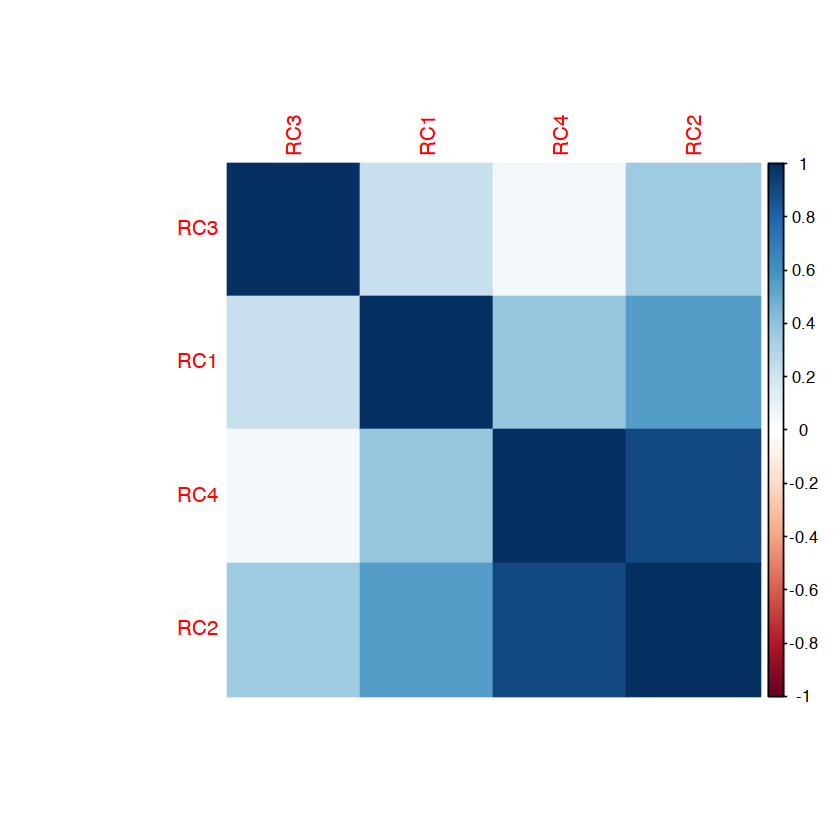

In [30]:
### Correlation plot of loadings
corrplot(cor(loadings[,1:4]), method = "color")

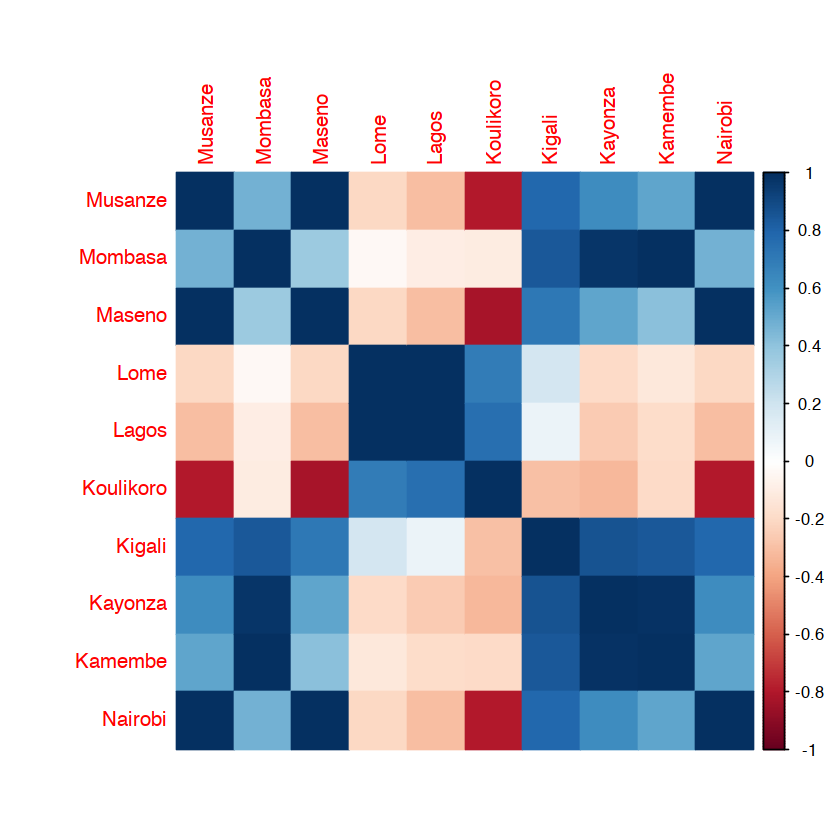

In [31]:
#corrgram::corrgram(cor(t(loadings[,1:4])),lower.panel = NULL)

corrplot(cor(t(loadings[,1:4])), method = "color")

### (iii) Perform a cross-correlation analysis of the two PFs.

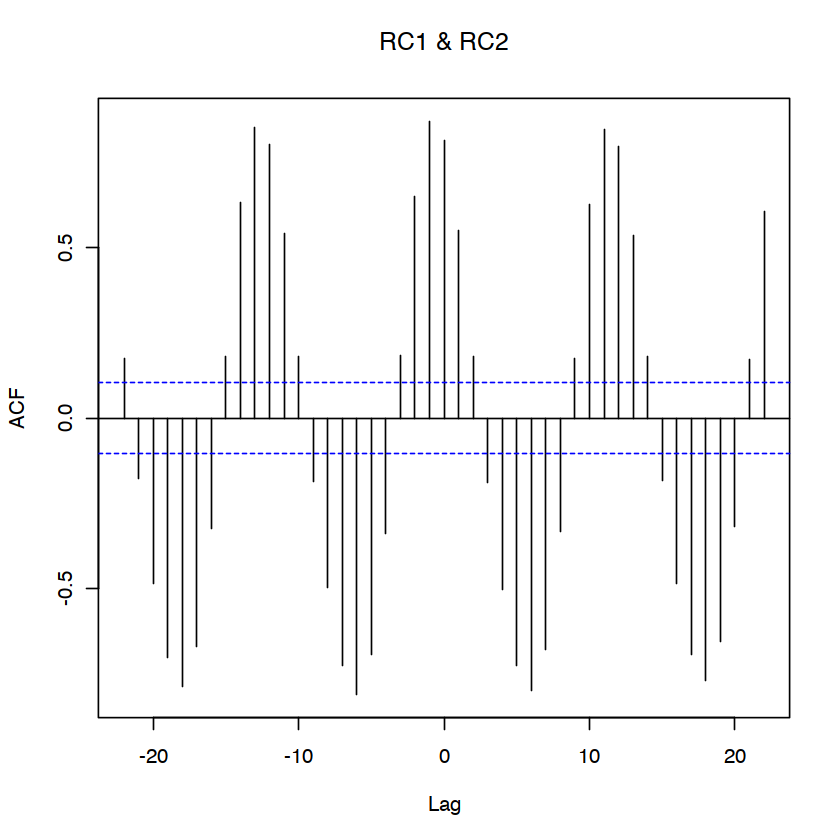

In [32]:
#acf(x, lag.max = NULL,type = c("correlation", "covariance", "partial"),plot = TRUE, na.action = na.fail, demean = TRUE, ...)

#pacf(x, lag.max, plot, na.action)

## Default S3 method:
#pacf(x, lag.max = NULL, plot = TRUE, na.action = na.fail)

#ccf(RCs[,2], RCs[,4], lag.max = NULL, type = c("correlation", "covariance"),plot = TRUE, na.action = na.fail)

## S3 method for class 'acf'
RC1  <-  y
RC2 <- y2
ccf(RC1, RC2, lag.max = NULL, type = c("correlation", "covariance"),plot = TRUE, na.action = na.fail)


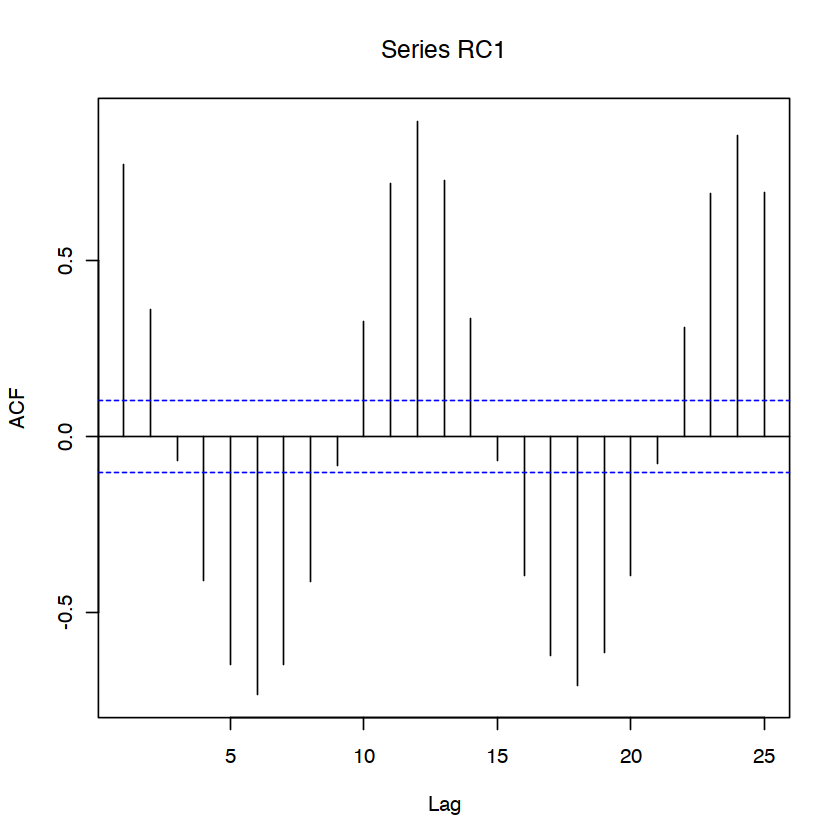

In [33]:
#acf(RCs[,2],lag.max =10,plot=T)

RC1 <-  y
acf(RC1,plot=T)

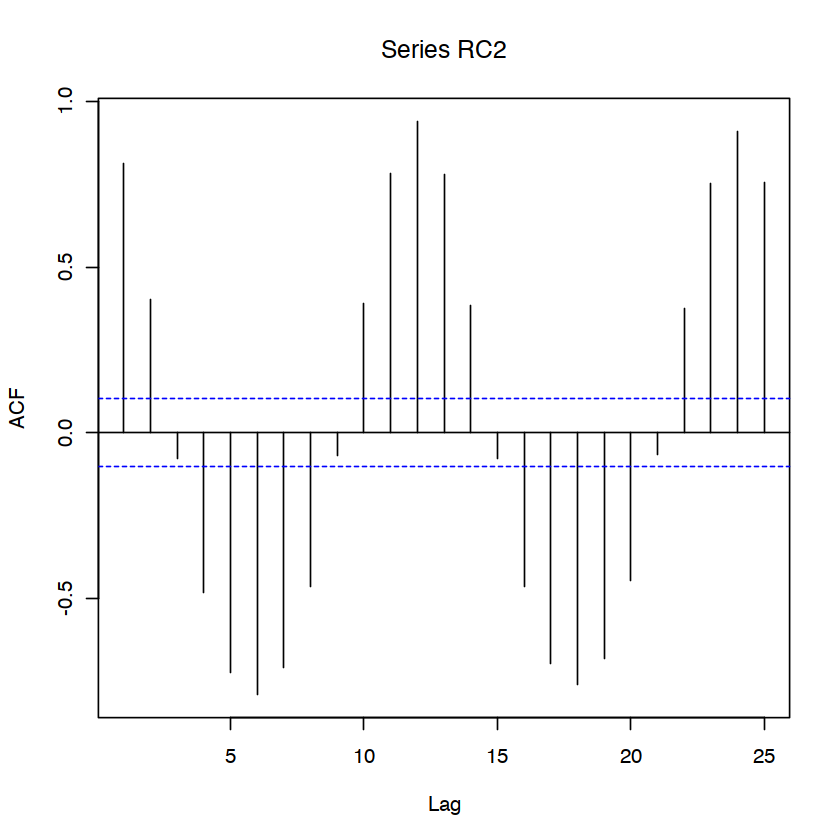

In [34]:
#acf(RCs[,4],lag.max =10, plot=T)
RC2 <-  y2
acf(RC2,plot=T)

geom_path: Each group consists of only one observation. Do you need to adjust
the group aesthetic?



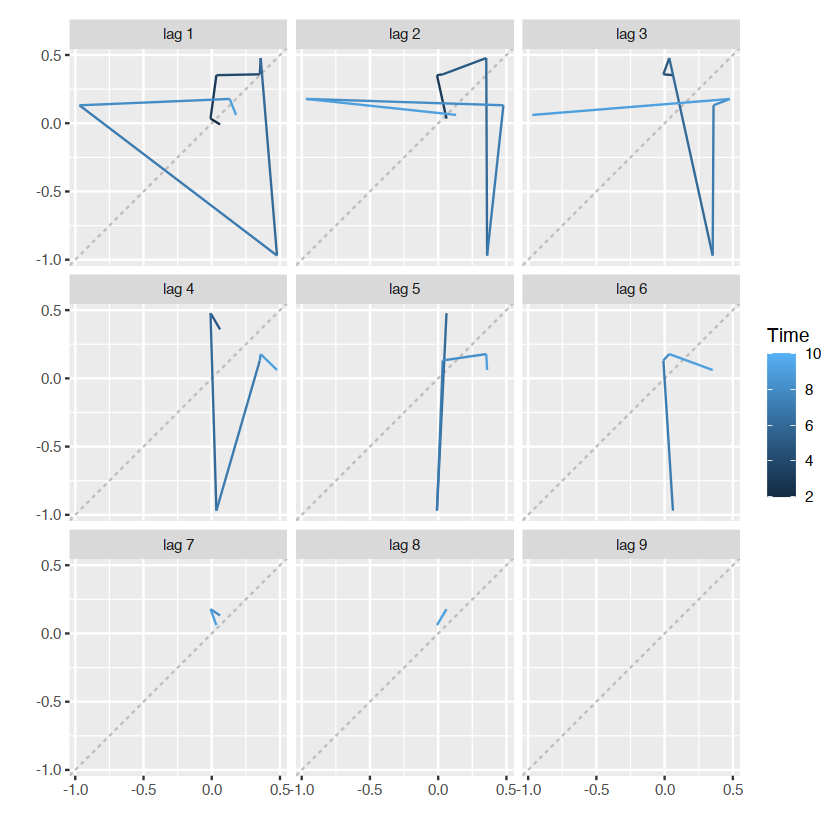

In [35]:
gglagplot(RCs[,4])

In [49]:
ts_cities_1 <- ts(c(y),start=c(1960,1),end=c(2010,12),frequency=12)
ts_cities_2 <- ts(c(y2),start=c(1960,1),end=c(2010,12),frequency=12)

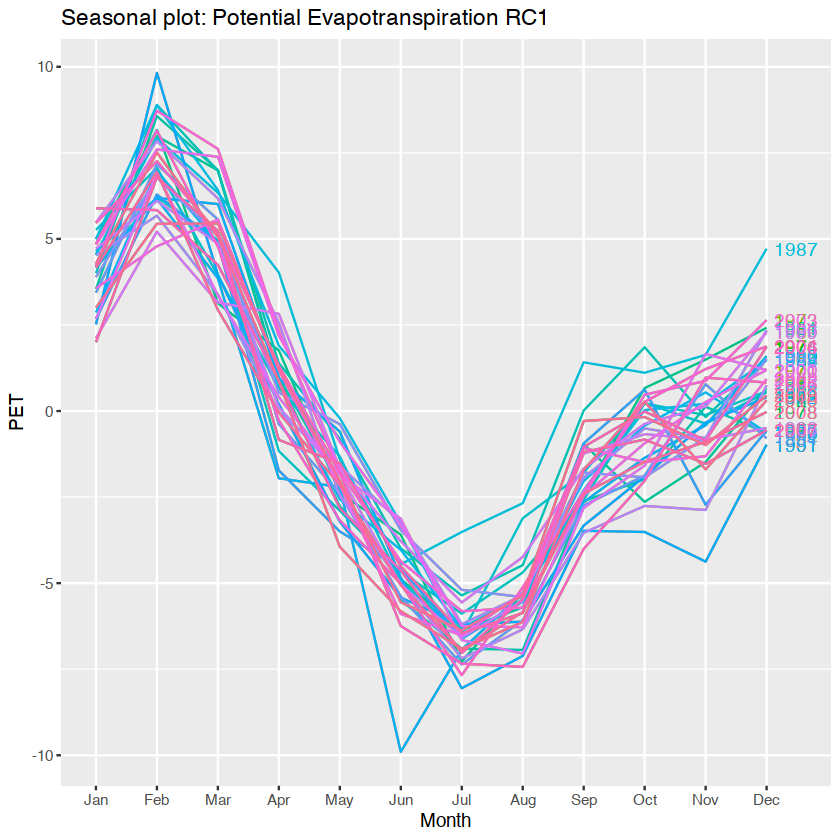

In [50]:
ggseasonplot(ts_cities_1, year.labels=TRUE, year.labels.left=F) +
  ylab("PET") +
  ggtitle("Seasonal plot: Potential Evapotranspiration RC1")

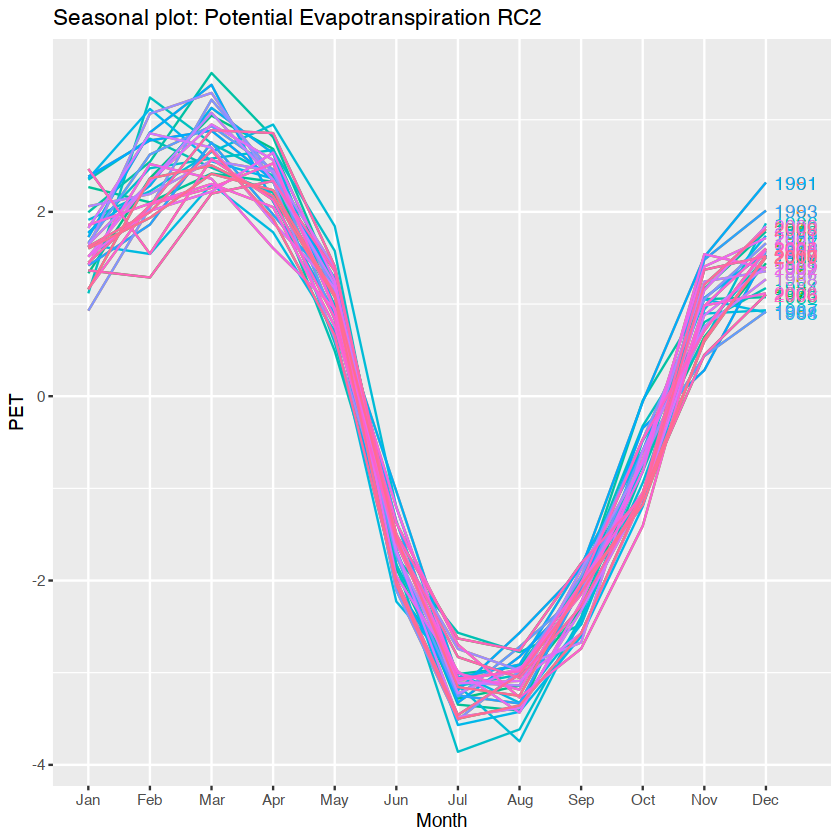

In [51]:
ggseasonplot(ts_cities_2, year.labels=TRUE, year.labels.left=F) +
  ylab("PET") +
  ggtitle("Seasonal plot: Potential Evapotranspiration RC2")

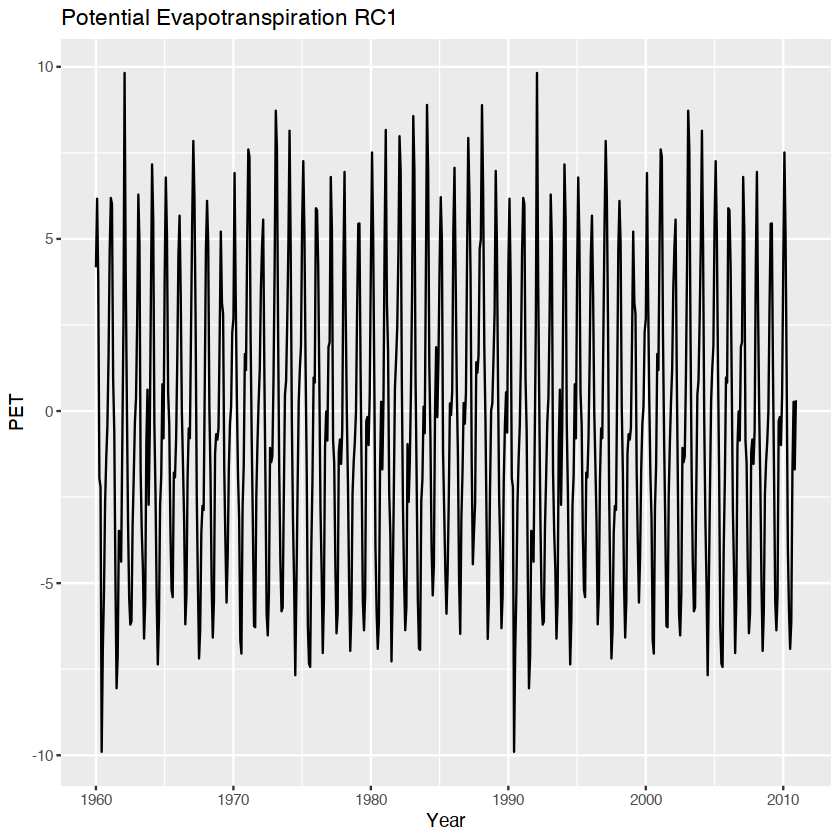

In [52]:
autoplot(ts_cities_1) +
  ggtitle("Potential Evapotranspiration RC1") +
  xlab("Year") +
  ylab("PET")

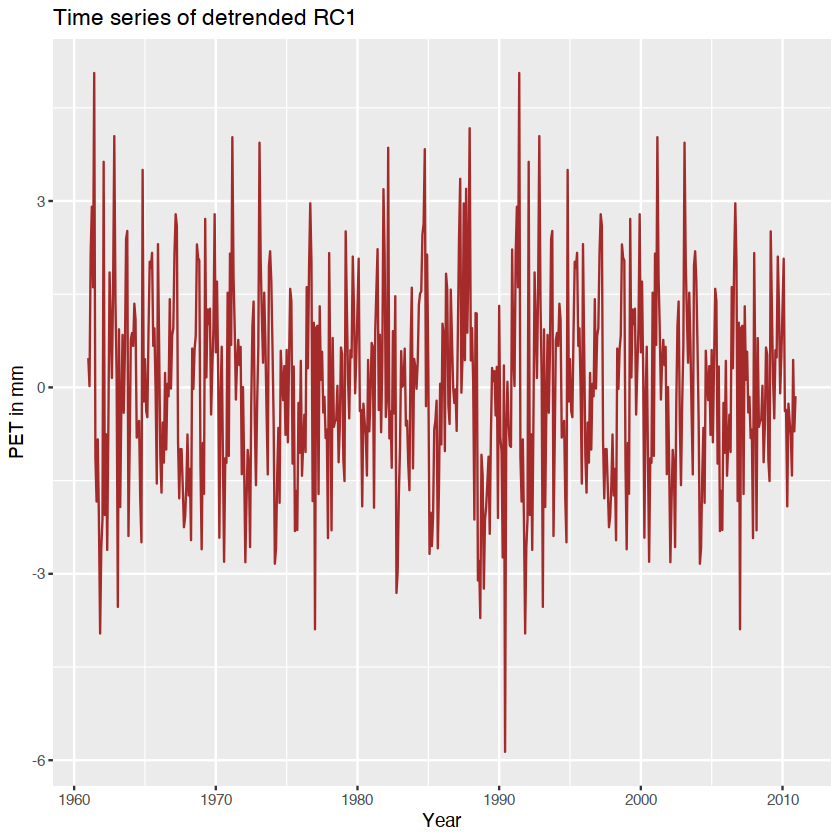

In [53]:
detrended.1 <- diff(ts_cities_1, lag = 12)

autoplot(detrended.1,colour='brown') +
  ggtitle("Time series of detrended RC1") +
  xlab("Year") +
  ylab("PET in mm") 

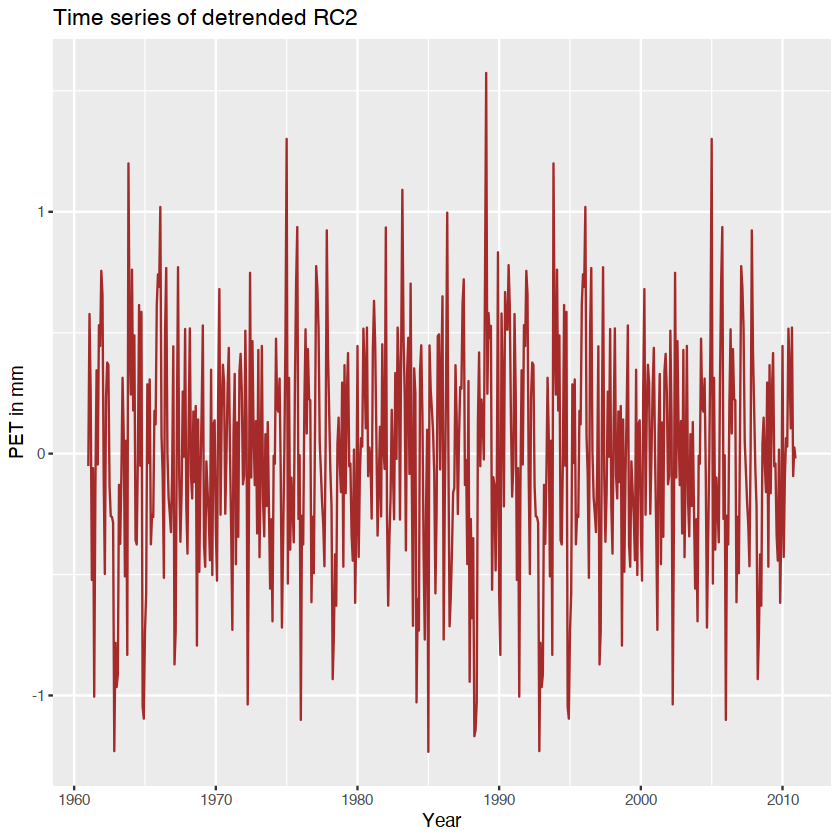

In [54]:
detrended.2 <- diff(ts_cities_2, lag = 12)

autoplot(detrended.2,colour='brown') +
  ggtitle("Time series of detrended RC2") +
  xlab("Year") +
  ylab("PET in mm") 

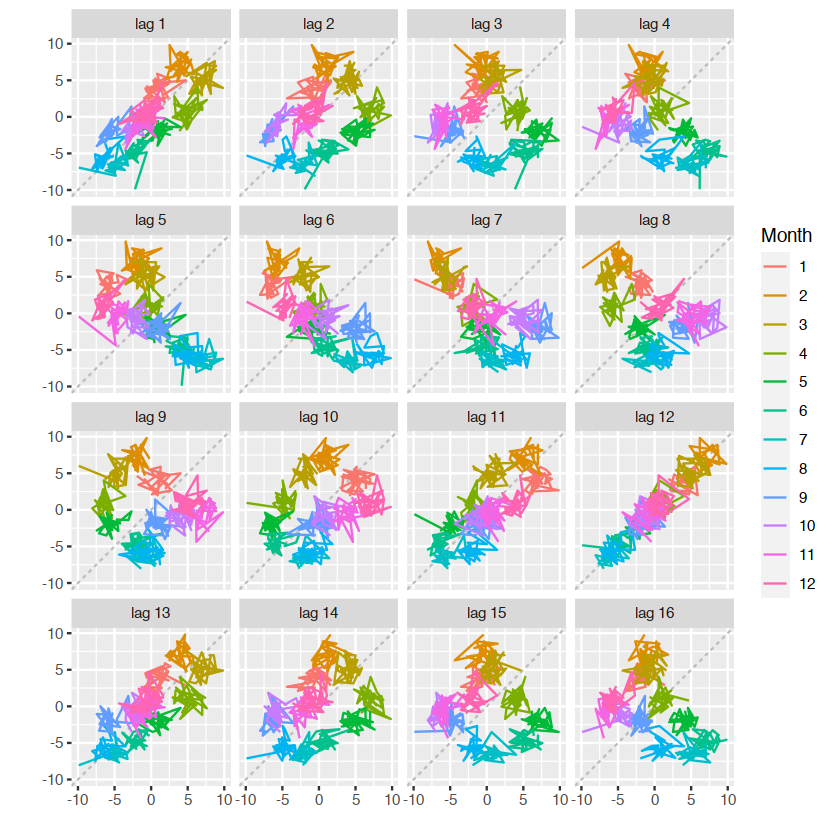

In [42]:
yy <- window(ts_cities_1, start=1960)
gglagplot(yy)

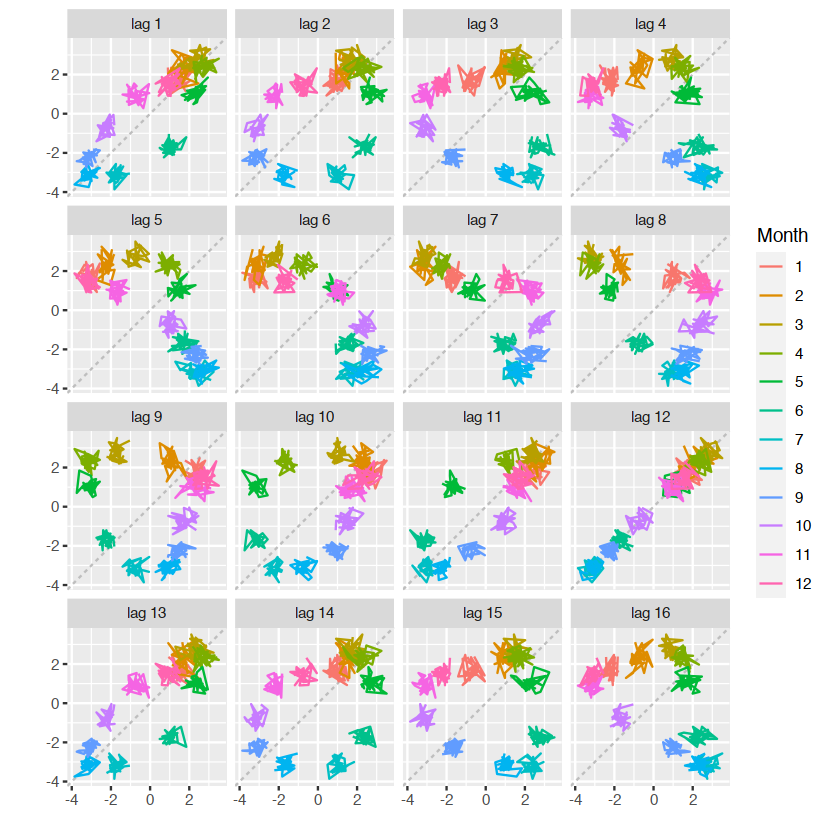

In [43]:
yyy <- window(ts_cities_2, start=1960)
gglagplot(yyy)

## TASK 4: Time-series Analysis Part II (Spectral Analysis and Wavelet Analysis)

In [44]:
### converting data to time series
RC1_ts <- ts(scores$RC1, start = c(1960,1), end = c(2010,12), frequency = 12)
RC2_ts <- ts(scores$RC2, start = c(1960,1), end = c(2010,12), frequency = 12)

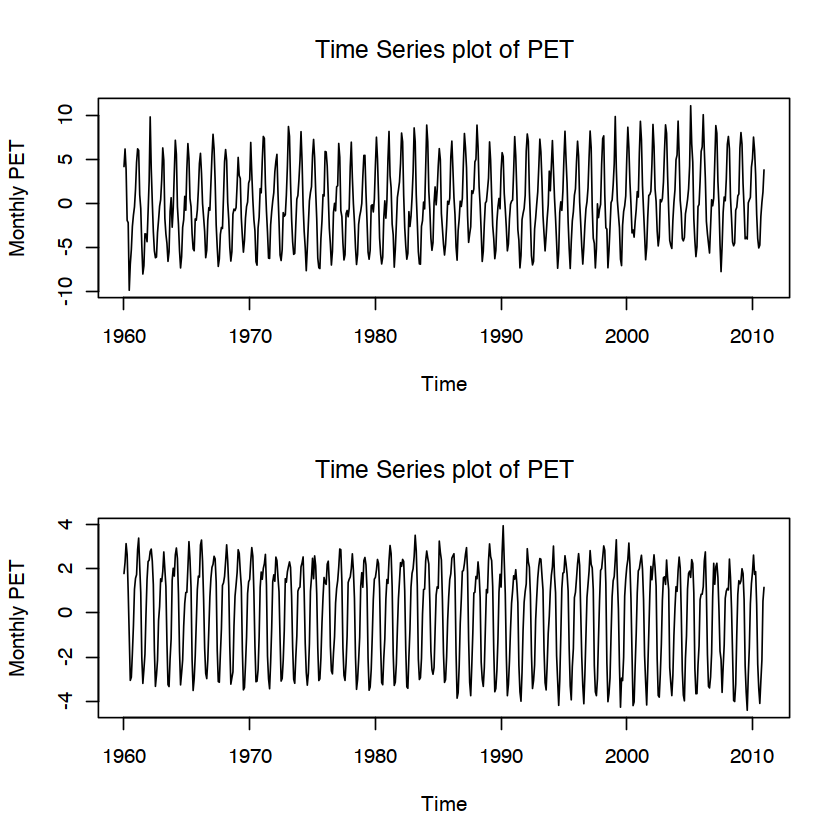

In [45]:
par(mfcol = c(2,1))
plot(RC1_ts, ylab = 'Monthly PET', main = 'Time Series plot of PET', col='black')
plot(RC2_ts, ylab = 'Monthly PET', main = 'Time Series plot of PET', col='black')


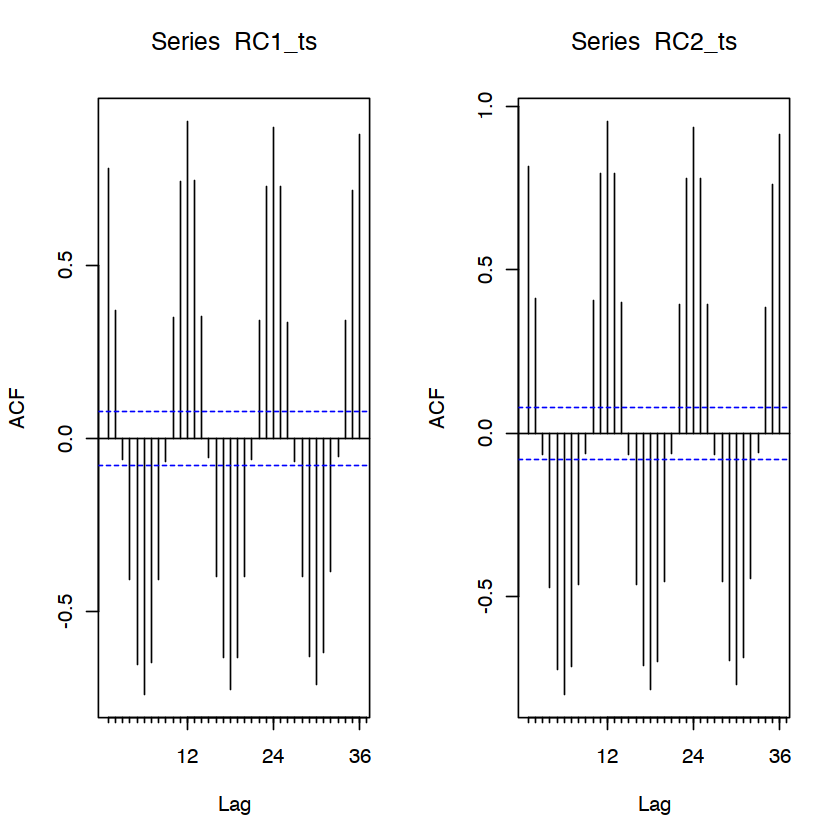

In [46]:
### Autocorrelation plot
par(mfcol = c(1,2))
forecast::Acf(RC1_ts, lag.max = 36)
forecast::Acf(RC2_ts, lag.max = 36)


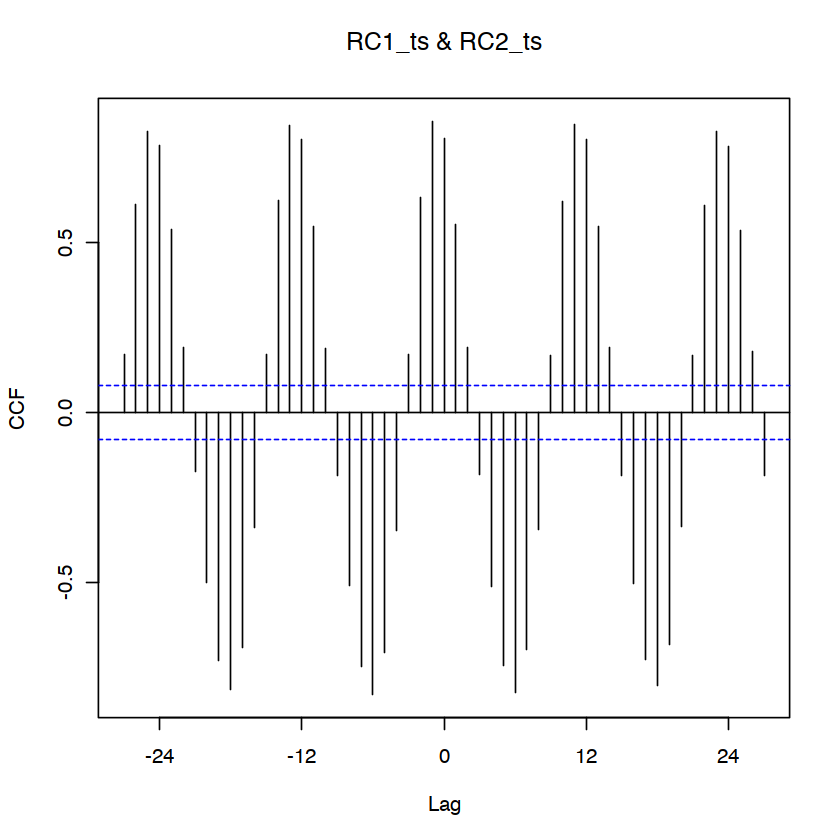

In [47]:
### cross-correlation plot
par(mfcol = c(1,1))
forecast::Ccf(RC1_ts,RC2_ts)

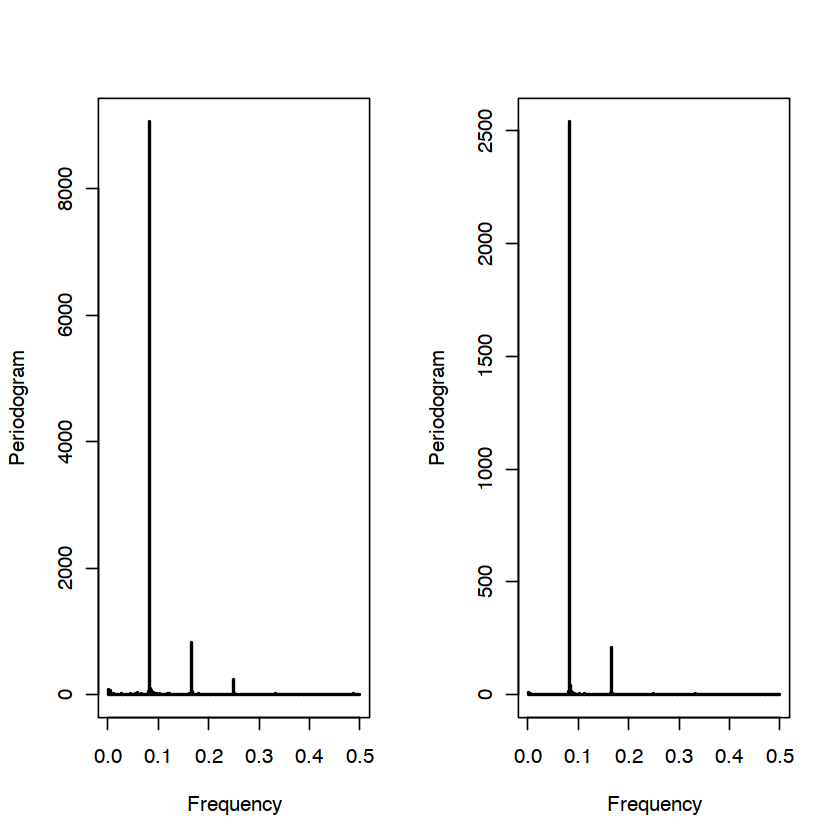

In [55]:
###################---------------------------###################
#################                                 ###############
#                       Time Series Analysis                    #
#                         Fourier Analysis                      #
#################                                 ###############
###################---------------------------###################
par(mfcol = c(1,2))
p1 <- periodogram(RC1_ts)
p2 <- periodogram(RC2_ts)


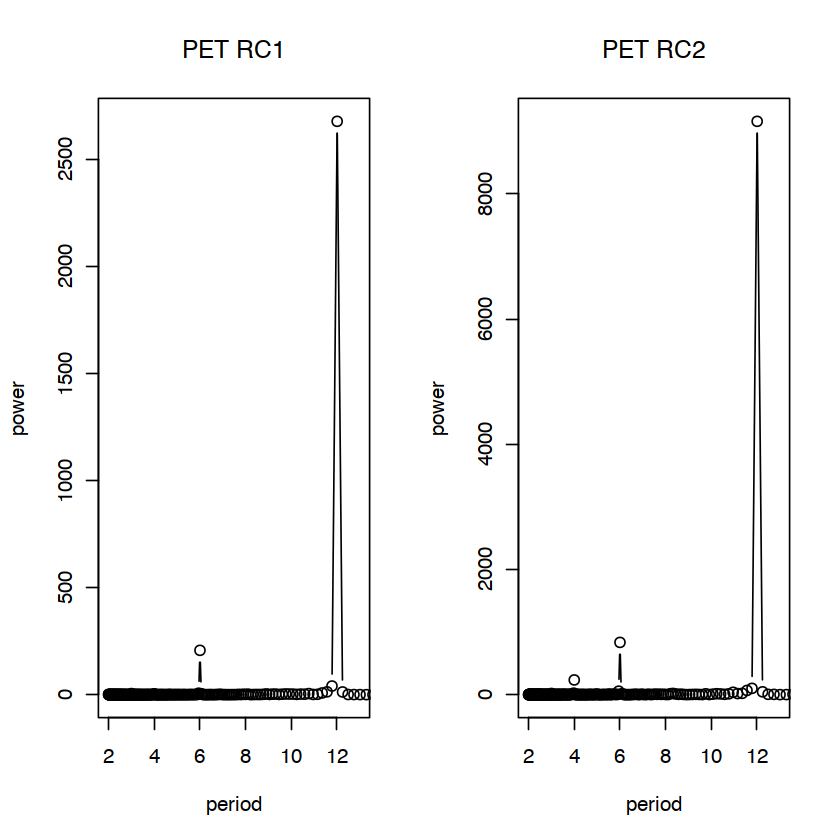

In [45]:
## converting the frequency to periods
period_RC1 <- 1/p1$freq
period_RC2 <- 1/p2$freq

par(mfcol = c(1,2))
plot(period_RC1, p$spec, type = 'b', xlim = c(2,13), xlab = 'period', ylab = 'power',
     main = 'PET RC1')

plot(period_RC2, p1$spec, type = 'b', xlim = c(2,13), xlab = 'period', ylab = 'power',
     main = 'PET RC2')

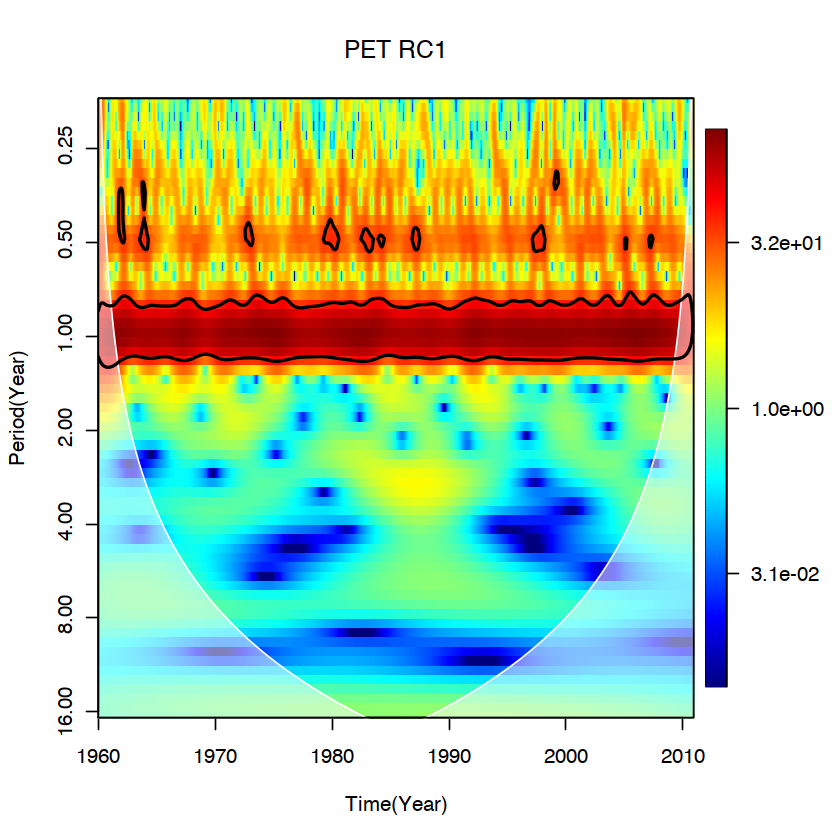

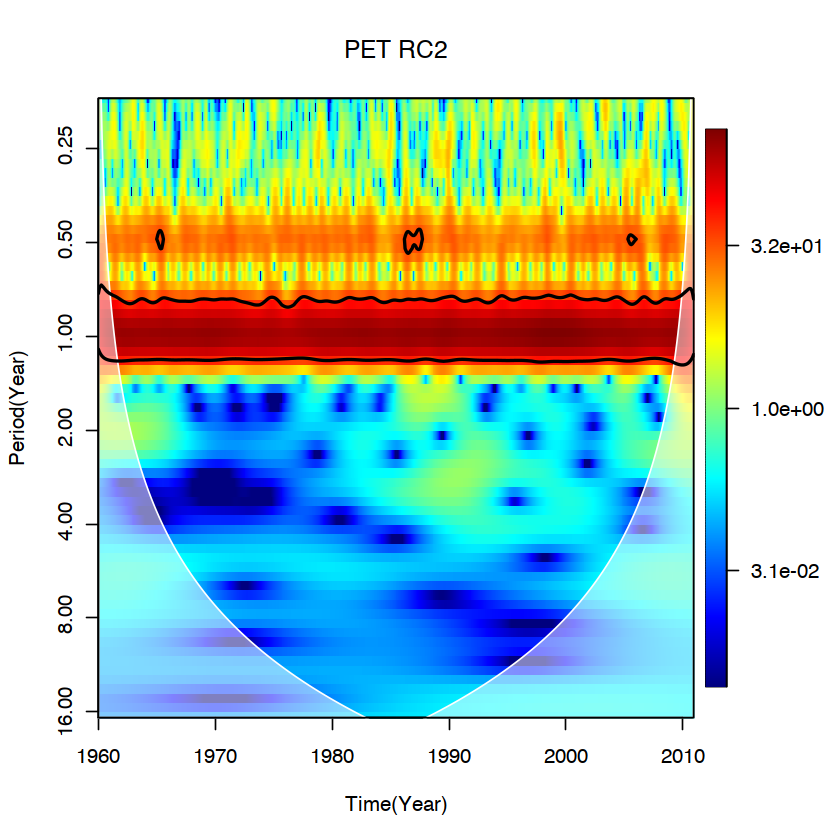

In [48]:
###################---------------------------###################
#################                                 ###############
#                       Time Series Analysis                    #
#             Wavelet Analysis and Wavelet Coherence            #
#################                                 ###############
###################---------------------------###################

## Wavelet
timelong=seq(1960, 2011-1/12, 1/12)  # indexing
wavelet1=wt(cbind(timelong,RC1_ts),dj=0.1,mother="morlet",max.scale=16) #wavelet
wavelet2=wt(cbind(timelong,RC2_ts),dj=0.1,mother="morlet",max.scale=16) #wavelet

## plot of wavelet
par(mfcol = c(1,1))
par(oma=c(0, 0, 0, 1), mar=c(5, 4, 4, 5) + 0.1)
xx=plot(wavelet1,  plot.cb = TRUE,lwd.coi = 1,col.coi="white",alpha.coi=0.5,col.sig="black",
        lwd.sig = 2, ncol = 768, tol = 0.95, plot.phase=F,ylab="Period(Year)", xlab = "Time(Year)",
        main='PET RC1')

#par(oma=c(0, 0, 0, 1), mar=c(5, 4, 4, 5) + 0.1)
yy=plot(wavelet2,  plot.cb = TRUE,lwd.coi = 1,col.coi="white",alpha.coi=0.5,col.sig="black",
        lwd.sig = 2, ncol = 768, tol = 0.95, plot.phase=F,ylab="Period(Year)", xlab = "Time(Year)",
        main='PET RC2')


  |======================================================================| 100%


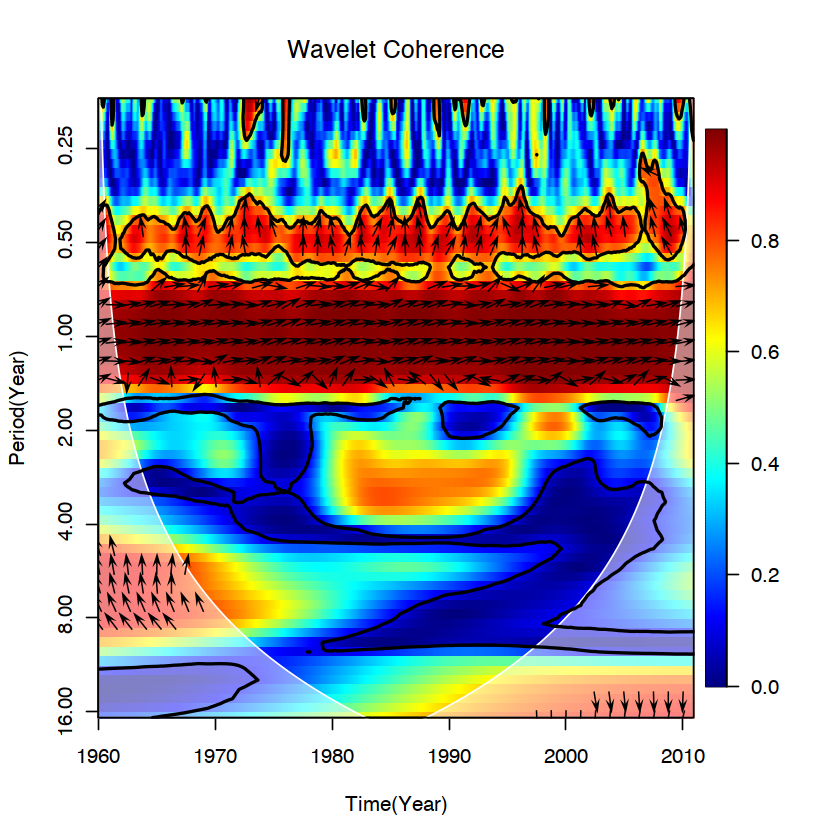

In [49]:
# wavelet coherence calculation
wcoh=wtc(cbind(timelong,RC1_ts),cbind(timelong,RC2_ts),dj=0.1,mother="morlet",max.scale=16) 

## plot of wavelet coherence
par(mfcol = c(1,1))
par(oma=c(0, 0, 0, 1), mar=c(5, 4, 4, 5) + 0.1) #To allow for colour bar to be included
plot(wcoh,  plot.cb = TRUE,lwd.coi = 1,col.coi="white",alpha.coi=0.5,col.sig="black",
     lwd.sig = 2, ncol = 768, tol = 0.95, plot.phase=T,ylab="Period(Year)", xlab = "Time(Year)",
     main='Wavelet Coherence') #plotting